# Extract Spectra (SIFS-Skipper)

In [15]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import sys,os
import numpy as np
from scipy.signal import find_peaks
from astropy.stats import sigma_clip, sigma_clipped_stats
from astropy.io import fits
from astropy.modeling import models, fitting
from collections import OrderedDict
import matplotlib
import matplotlib.pyplot as plt
from astropy.visualization import ImageNormalize
from astropy.visualization import (MinMaxInterval, ZScaleInterval,
                                   AsymmetricPercentileInterval,)
from astropy.visualization import SqrtStretch, AsinhStretch, HistEqStretch

from astropy.time import Time
from astropy.coordinates import SkyCoord, EarthLocation
import astropy.units as u
import astropy.constants as const

from scipy.optimize import curve_fit
from scipy.special import voigt_profile
from scipy.interpolate import interp1d

from scipy.optimize import minimize
from scipy.linalg import inv



matplotlib.pyplot.set_loglevel (level = 'warning')

## Data 
###### The data for this process cosists of reduced 'OBJECT' images and calibration lamp images

In [16]:
# OBJECT
bd_18_star =['/data/des81.b/data/emarrufo/SIFS_data/SIFS_DATA/20240722_TEST/20240722/OBJECT/BD-18/proc_sk20240722_bd18_0045.fits']

# CuHeAr 

cuhear = ['/data/des81.b/data/emarrufo/SIFS_data/SIFS_DATA/20240722_TEST/20240722/COMP/CuHeAr/proc_sk20240722_cuhear0042.fits']

# HgHeAr

hghear = ['/data/des81.b/data/emarrufo/SIFS_data/SIFS_DATA/20240722_TEST/20240722/COMP/HgArNe/proc_sk20240722_hgarne0041.fits']



## Helper Functions 

In [35]:
def fit_polynomial(x, y, degree=3):
    
    """
    Fit a polynomial of given degree to x-y data.

    Parameters
    ----------
    x : numpy.ndarray
        Array of x-values.
    y : numpy.ndarray
        Array of y-values.
    degree : int, optional
        Polynomial degree to fit. Defaults to 3.

    Returns
    -------
    numpy.ndarray
        1D array of polynomial coefficients (highest power first).
    """
    coeffs = np.polyfit(x, y, degree)
    return coeffs

def pixel_to_wavelength(pixel_pos, coeffs):
    
    """
    Evaluate a polynomial at given pixel positions to convert to wavelength.

    Parameters
    ----------
    pixel_pos : numpy.ndarray
        1D array of pixel positions.
    coeffs : numpy.ndarray
        Polynomial coefficients from e.g., `np.polyfit`.

    Returns
    -------
    numpy.ndarray
        Wavelength values corresponding to each pixel position.
    """
    return np.polyval(coeffs, pixel_pos)


def detector_image(paths,hdu_num,det_num):
    """
    Load and combine amplifier HDUs into 'detector' images for each file.

    Parameters
    ----------
    paths : list of str
        List of FITS file paths to load.
    hdu_num : int
        Number of HDUs/amplifiers to read from each file.
    det_num : int
        Number of detectors to reshape the amplifier images into.

    Returns
    -------
    numpy.ndarray
        4D array of shape (n_files, det_num, n_rows, n_cols), where
        n_files = len(paths).
    """
    reduced_img = list()
    detectors = list()
    for filename in paths:
        img = fits.open(filename)
        for hdu in range(hdu_num):
            image = img[hdu+1].data[:,:]
            hdr = img[hdu+1].header

            data_sec = hdr['DATASEC']
            data_sec = data_sec.strip('[]').split(',')
            slices = [slice(*map(int, pair.split(':'))) for pair in data_sec]

            image = image.T[slices].T
            reduced_img.append(image)
    
    reduced_img = np.array(reduced_img)
    combined_data = reduced_img.reshape(len(paths),hdu_num,reduced_img.shape[1],reduced_img.shape[2])
    
    # For each file combined amps to form "detector" images 
    
    for reduced_img in combined_data:
        detectors_array = reduced_img.reshape(det_num,int(len(reduced_img)/det_num),reduced_img.shape[1],reduced_img.shape[2])
        for i in range(detectors_array.shape[0]):
            detector = np.vstack((np.hstack((detectors_array[(i, 0)], detectors_array[i, 2])), #0,2 1,3
                                  np.hstack((detectors_array[i, 1], detectors_array[i, 3]))))
            
            detectors.append(detector)
    
    detectors = np.array(detectors)
    
    detectors = np.array(detectors).reshape(len(paths),det_num,detectors.shape[1],detectors.shape[2])
    
    
    return detectors


def plot_detector(paths,col_slice):
    """
    Plot each detector image from a set of files, focusing on a column slice.

    Parameters
    ----------
    paths : list of str
        List of FITS file paths.
    col_slice : tuple of int
        (start_col, end_col) specifying the slice in columns to plot.

    Returns
    -------
    None
    """
    hdu_num = 16
    det_num = 4
    
    detector_img = detector_image(paths,hdu_num,det_num)


    
    # Slice in "column" space to minimize curvature 
        
    detector_img_sliced = detector_img#[:,:,:,col_slice]
    
    for det in range(det_num):
        fig, ax = plt.subplots(figsize=(30, 20))
        norm = ImageNormalize(detector_img_sliced[0,det,:,:], 
                      interval=ZScaleInterval(nsamples=1000,
                                              contrast=0.07,
                                              krej=15.5),
                                              stretch=SqrtStretch())
        plt.imshow(detector_img_sliced[0,det,:,:], origin='lower', norm=norm, cmap='gray')
        plt.tick_params(axis='both', labelsize=25)
        plt.show()




def create_meta_data(det, **data_products):
    """
    Create a metadata dictionary for a given detector, including known line references.

    Parameters
    ----------
    det : int
        Detector index (0, 1, or 2).
    **data_products : dict
        Additional data (e.g., 'pixel_refernces'=...).

    Returns
    -------
    OrderedDict
        Contains 'Detector', 'Reference Wavelengths', and any extra data.
    """
    # Reference wavelengths
    det_2_wavelengths = [4847.8100, 4879.86, 4889.0420, 4965.0800, 5017.1630, 5165.7730, 5460.7350]
    
    det_1_wavelengths = [5769.5980, 5790.6630, 5852.4879, 5881.8952, 5944.8342, 6074.3377,
                         6096.1631, 6143.0626, 6163.5939, 6217.2812, 6266.4950, 6304.7889, 6334.4278]
    
    det_0_wavelengths = [6506.5281,6532.8822,6598.9529,6678.2762, 6717.0430,6929.4673,6965.4310]


    metadata = OrderedDict()

    if det == 1:
        metadata['Detector'] = 'Detector 1'
        metadata['Reference Wavelengths'] = det_1_wavelengths
    elif det == 2:
        metadata['Detector'] = 'Detector 2'
        metadata['Reference Wavelengths'] = det_2_wavelengths
    
    elif det == 0:
        metadata['Detector'] = 'Detector 0'
        metadata['Reference Wavelengths'] = det_0_wavelengths
    else:
        raise ValueError("Invalid detector number. Please input 0,1 or 2.")

    for key, value in data_products.items():
        metadata[key] = value

    return metadata


def spectrum_peak_loc(spectrum_data,height = 2600, width =1, plot=True): 
    """
    Identify peaks in 1D spectrum data using `scipy.signal.find_peaks`.

    Parameters
    ----------
    spectrum_data : np.ndarray
        1D array of spectral intensities.
    height : float, optional
        Minimum required height of peaks. Defaults to 2600.
    width : float, optional
        Minimum width of peaks. Defaults to 1.
    plot : bool, optional
        If True, plots the spectrum and identified peaks. Defaults to True.

    Returns
    -------
    np.ndarray
        1D array of indices where peaks were found.
    """
    peaks, _ =  find_peaks(spectrum_data, height=height,width=width)
    
    if plot:
        plt.figure(figsize=(15, 3))
        plt.plot(spectrum_data, label='Spectrum')
        plt.plot(peaks, spectrum_data[peaks], 'ro', label='Peaks')
        plt.xlabel('Pixel Position')
        plt.ylabel('Intensity')
        plt.title('Spectrum with Identified Peaks')
        plt.legend(loc='best')
        plt.grid(True)
        plt.ylim(0,65)
        plt.show()
    
    return peaks

def extract_spectrum_collapsed(img_file, spectrum_slice=slice(None,None)):
    """
    Collapse a detector image across columns (or rows) to extract a 1D spectrum.

    Parameters
    ----------
    img_file : list of str
        List of paths to one or more FITS files.
    spectrum_slice : slice, optional
        Slice specifying which columns to include. Defaults to all columns.

    Returns
    -------
    np.ndarray
        A 2D array of shape (detector_num, n_rows) containing the median
        across the specified columns.
    """
    HDUs=16
    detector_num = 4
    spectrum_raw = detector_image(img_file,HDUs,detector_num)
    return  np.median((spectrum_raw[0,:,:,spectrum_slice]),axis=2)
    
            
            
def refine_peak_loc(peaks,spectrum,plot=True):
    """
    Refine peak locations in a 1D spectrum using Voigt profile fits.

    Parameters
    ----------
    peaks : np.ndarray
        Integer array of approximate peak locations.
    spectrum : np.ndarray
        1D array of spectral intensities.
    plot : bool, optional
        If True, show fits for each peak. Defaults to True.

    Returns
    -------
    refined_peaks : list of float
        The refined sub-pixel peak locations.
    uncertainties : np.ndarray
        Estimated uncertainties for each x_0 position (cov diagonal).
    """
    window=5
    refined_peaks = list()
    fitted_models =list()
    uncertainty=list()
    
    plt.close('all')  
    for peak in peaks:
        start = max(0, peak - window)
        end = min(len(spectrum), peak + window)
        x_data = np.arange(start, end)
        y_data = spectrum[start:end]
        y_noise = np.sqrt(y_data)
        weights = 1 / y_noise
        
        
        voigt_init = models.Voigt1D(amplitude_L=max(y_data), x_0=peak, fwhm_L=0.5, fwhm_G=1.0)
        
     
        
        fit   = fitting.LevMarLSQFitter(calc_uncertainties=True)
        fitted_model = fit(voigt_init, x_data, y_data, weights=weights)
        cov_matrix = fit.fit_info['param_cov']
        x_0_index = list(fitted_model.param_names).index('x_0')
        x_0_uncertainty = (cov_matrix[x_0_index, x_0_index])
        uncertainty.append(x_0_uncertainty)
        
        refined_peak = fitted_model.x_0.value
        refined_peaks.append(refined_peak)
        fitted_models.append(fitted_model)
        
        if plot:
            x_smooth = np.linspace(start, end, 50)  
            y_smooth = fitted_model(x_smooth)
            
            plt.plot(x_data, y_data, 'ko', label='Data')
            plt.plot(x_smooth, y_smooth, 'r-', label='Fit')  
            plt.axvline(refined_peak, color='blue', linestyle='--', label='Refined Peak')
            plt.legend()
            plt.show()
    
    return refined_peaks, np.array(uncertainty)



def exclude_peaks(spectrum, peak_locations):
    """
    Interactively exclude or accept peak locations in a 1D spectrum.

    Parameters
    ----------
    spectrum : np.ndarray
        1D array of spectral intensities.
    peak_locations : np.ndarray
        1D array of peak indices identified earlier.

    Returns
    -------
    list of int
        The user-approved list of peaks.
    """
    updated_peaks = []

    for peak in peak_locations:
        plt.close('all')  

        fig = plt.figure(figsize=(15, 3))
        
        plt.plot(spectrum[:-1], linestyle='--', color='slateblue', label='HgArNe')
        
        for kept_peak in updated_peaks:
            plt.annotate(
                'Peak',
                xy=(kept_peak, spectrum[kept_peak]),
                xytext=(kept_peak, spectrum[kept_peak] + 0.05 * max(spectrum)),
                arrowprops=dict(facecolor='blue', shrink=0.05),
            )
        
        plt.annotate(
            'Peak',
            xy=(peak, spectrum[peak]),
            xytext=(peak, spectrum[peak] + 0.05 * max(spectrum)),
            arrowprops=dict(facecolor='red', shrink=0.05),
        )
        
        plt.xlabel('Pixel Position',fontsize=25)
        plt.ylabel('Intensity',fontsize=25)
        plt.legend(fontsize=17)
        plt.tick_params(axis='both', labelsize=25)
        plt.ylim(0,20000)

        plt.pause(0.1)  # Pause to update the plot

        # Ask user for input
        keep = input(f"Keep peak at location {peak}? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): ")
        
        # If kept, add the peak to the list of kept peaks
        
        if keep.lower() == 'q':
            sys.exit(0)
        elif keep.lower() == 'all':  
            break 
        elif keep.lower() != 'n':
            updated_peaks.append(peak)
        
        plt.close('all')  
    return updated_peaks

def pixel_locations(calibration, data_cu, data_hg, slice_arr,det,height=14):
    """
    Extract and refine peak positions from calibration arcs (Cu or Hg).

    Parameters
    ----------
    calibration : str
        'cu' or 'hg' to indicate the lamp data used.
    data_cu : list of str
        CuHeAr file paths.
    data_hg : list of str
        HgArNe file paths.
    slice_arr : list of slice
        Column slices for each fiber/bundle.
    det : int
        Detector index.
    height : float, optional
        Minimum peak height for `find_peaks`. Defaults to 14.

    Returns
    -------
    pixel_locs : np.ndarray
        2D object array with refined peak positions for each slice.
    spectral_size : int
        Number of columns in the extracted 1D spectrum.
    x0_uncer : np.ndarray
        Uncertainties for each peak location.
    """
    
    pixel_locs = list()
    x0_uncer = list()
    
    if calibration == 'cu':
        
        for slc in slice_arr:
            calibration_data = data_cu
            calibration_spectrum =  extract_spectrum_collapsed(calibration_data, slc)
            calibration_spectrum_peaks = spectrum_peak_loc(calibration_spectrum[det,:], height=height,plot=False)
            calibration_spectrum_peaks = exclude_peaks(calibration_spectrum[det,:], calibration_spectrum_peaks)
            calibration_spectrum_peaks_refined, x0_unc = refine_peak_loc(calibration_spectrum_peaks,calibration_spectrum[det,:])
            
            pixel_locs.append(calibration_spectrum_peaks_refined)
            
            spectral_size = len(calibration_spectrum[det,:])
            
            x0_uncer.append(x0_unc)
            
    
    elif calibration == 'hg':
        
        for slc in slice_arr:
            calibration_data = data_hg
            calibration_spectrum =  extract_spectrum_collapsed(calibration_data, slc)
            calibration_spectrum_peaks = spectrum_peak_loc(calibration_spectrum[det,:], height=height,plot=False)
            calibration_spectrum_peaks = exclude_peaks(calibration_spectrum[det,:], calibration_spectrum_peaks)
            calibration_spectrum_peaks_refined,x0_unc = refine_peak_loc(calibration_spectrum_peaks,calibration_spectrum[det,:])
            
            pixel_locs.append(calibration_spectrum_peaks_refined)
            spectral_size = len(calibration_spectrum[det,:])
            x0_uncer.append(x0_unc)


    
    return np.array(pixel_locs), spectral_size, np.array(x0_uncer)



def process_subarray(subarray, med_array,max_len):
    """
    Combine `subarray` with a median array if `subarray` is too short, ensuring
    a unified set of peak positions without duplicates.

    Parameters
    ----------
    subarray : np.ndarray
        1D array of refined peak positions for one slice.
    med_array : np.ndarray
        1D array representing the median peak positions across slices.
    max_len : int
        The max length among all slices (to unify arrays).

    Returns
    -------
    np.ndarray
        Sorted array of final peak positions, no duplicates within ~10 pixels.
        """
    if len(subarray) < max_len:
        concatenated = np.concatenate((subarray, med_array))
    else:
        concatenated = subarray.copy()
        
    
    
    result = []
    for i, value in enumerate(concatenated):
        if i < len(subarray): 
            result.append(value)
        else:  
            if all(abs(value - x) >= 10 for x in result):  # If no close value exists
                result.append(value)

    return np.sort(np.array(result))




In [36]:
# Create a "detector" image 
bd_18_star_det = detector_image(bd_18_star,16,4)

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:74: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


## Target Image Slices

In [37]:
def select_slices(det_image,det_num,threshold= 20):
    """
    Interactively identify and keep column slices where the median signal
    in a sliding window exceeds a threshold.

    Parameters
    ----------
    det_image : np.ndarray
        4D array with shape (n_files, det_num, n_rows, n_cols).
    det_num : int
        Index of the detector to examine.
    threshold : float
        Minimum median signal to accept the window as part of a trace.

    Returns
    -------
    list of slice
        Slices specifying the chosen column ranges.
    """
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    norm = ImageNormalize(det_image[0,det_num,:,:], 
                          interval=ZScaleInterval(nsamples=1000,
                                                  contrast=0.5,
                                              krej=5.5),
                                              stretch=SqrtStretch())
    
    plt.imshow(det_image[0,det_num,:,:], origin='lower', norm=norm, cmap='gray')
    
    image = det_image[0, det_num, :, :]
    height, width = image.shape
    
  #np.median(det_image[0, det_num, :, 0:1000].flatten())

    
    # Define window size and step size
    window_size = 20
    step_size = 20  # Move by the window size for non-overlapping windows

    # List to hold the trace regions where the signal is significant
    traces = []
    
    
    for start_col in range(0, width - window_size + 1, step_size):
        end_col = start_col + window_size
        region = image[:, start_col:end_col]  # Extract the 20-pixel-wide region
        
        # Compute the median signal for the region
        median_signal = np.median(region)
        
        # Check if the median signal exceeds the threshold
        if median_signal > threshold:
            traces.append([start_col, end_col])
    
    if traces:
        min_col = min(t[0] for t in traces)
        max_col = max(t[1] for t in traces)
    else:
        min_col, max_col = 0, width 
        
    
    for t in traces:
        plt.fill_betweenx(np.arange(height), t[0], t[1], alpha=0.2, color='red')
    plt.show()
    
    
    # Zoomed-in version 
    
    fig, ax = plt.subplots(figsize=(20, 10))
    plt.tick_params(axis='both', labelsize=25)

    plt.imshow(det_image[0,det_num,:,:], origin='lower', norm=norm, cmap='gray')
    
    
    for t in traces:
        plt.fill_betweenx(np.arange(height), t[0], t[1], alpha=0.2)
    
    # Set x-limits for zooming in
    ax.set_xlim(min_col, max_col)

    plt.show()
    
    
    
    # Askig which traces to keep 
    
    kept_slices = []
    
    user_input = input("Press Enter to proceed to bundle selection, or type 'n'/'N' to exit: ")
    
    if user_input.lower() == 'n': 
        sys.exit(0)
    
    i = 0  # Initialize trace index

    while i < len(traces):
        t = traces[i]
        fig, ax = plt.subplots(figsize=(20, 10))
        plt.imshow(det_image[0, det_num, :, :], origin='lower', norm=norm, cmap='gray')
        
        # Overlay the current trace
        plt.fill_betweenx(np.arange(height), t[0], t[1], alpha=0.2, color='red')
        
        # Set the zoomed-in limits
        ax.set_xlim(min_col, max_col)
        
        # Show the plot
        plt.show()
        
        # Ask user for input
        user_input = input(f"Keep slice({t[0]}, {t[1]})? Press Enter to keep, type 'n'/'N' to discard, 'all' to discard the rest, or enter a number to skip that many traces: ")

        if user_input.lower() == 'n': 
            pass  
        elif user_input.lower() == 'all':  
            break 
        elif user_input.isdigit(): 
            skip_number = int(user_input)
            remaining_traces = len(traces) - (i + 1)
            if skip_number > remaining_traces:  # If skip number exceeds remaining traces
                print(f"Only {remaining_traces} traces left. Skipping all remaining traces.")
                break  # Skip the rest and exit the loop
            else:
                i += skip_number  # Skip the specified number of traces
                print(f"Skipping {skip_number} traces.")
                continue  # Continue to the next trace after skipping
        else:  # Any other input (including Enter) means the slice is kept
            kept_slices.append(slice(t[0], t[1]))
        
        plt.close(fig)
        i += 1  
    

    

    
    return kept_slices


refined_slices = select_slices(bd_18_star_det,0)

## Wavelength Solution

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:74: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


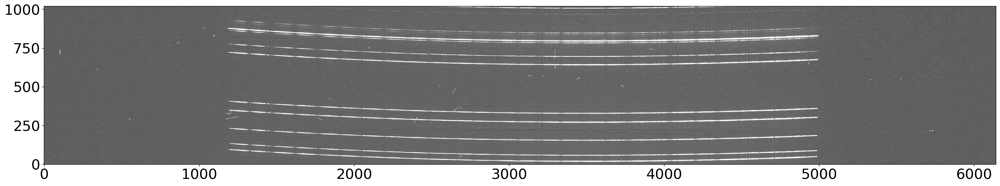

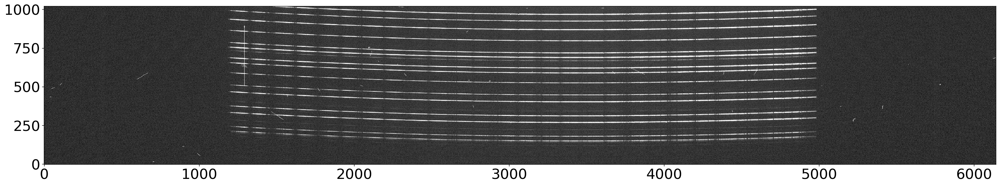

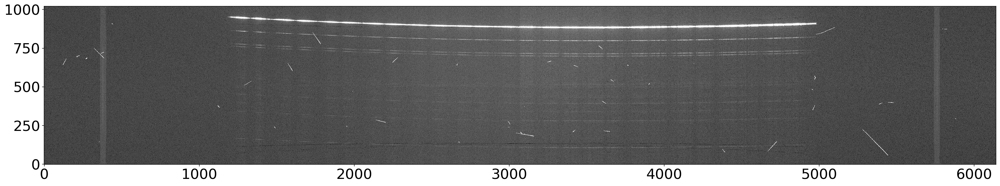

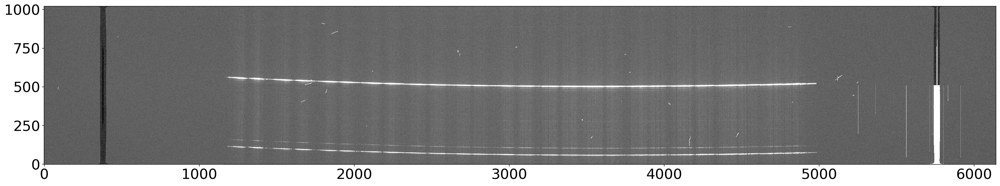

In [38]:
# plot detector image (calibration)
plot_detector(hghear,col_slice=(0,4000))

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


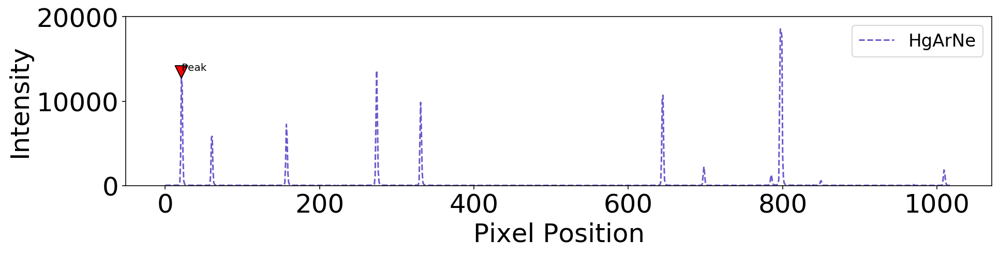

Keep peak at location 21? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


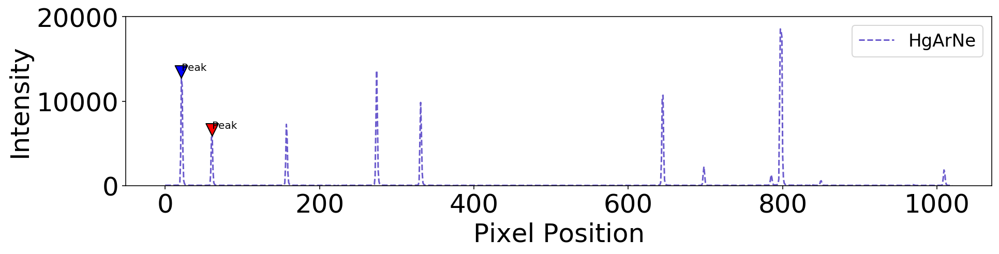

Keep peak at location 61? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


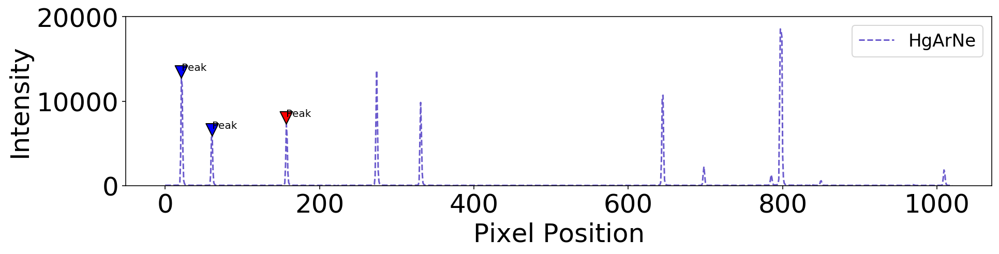

Keep peak at location 157? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


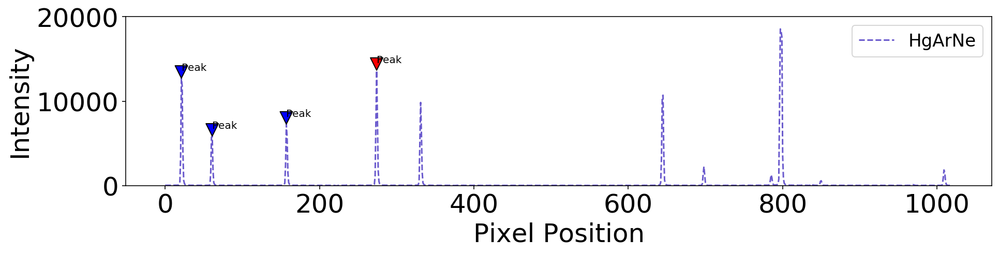

Keep peak at location 274? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


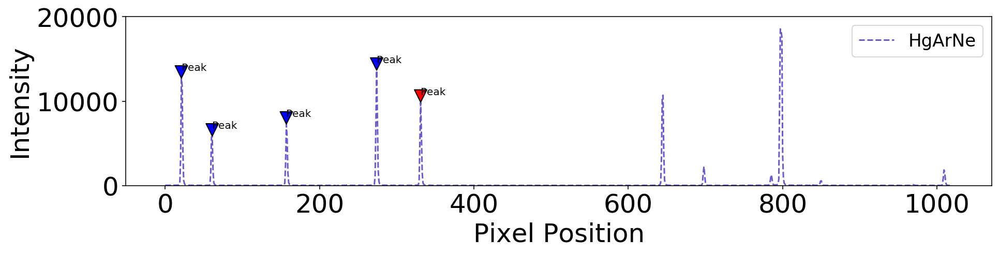

Keep peak at location 331? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


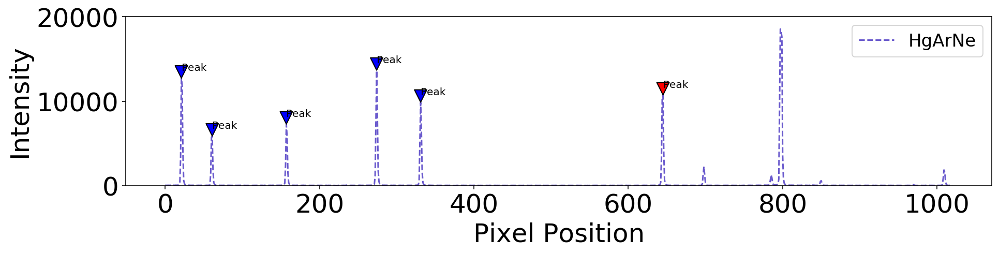

Keep peak at location 645? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


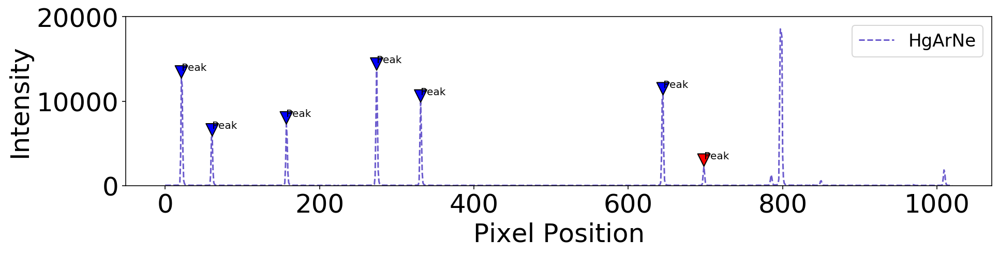

Keep peak at location 698? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


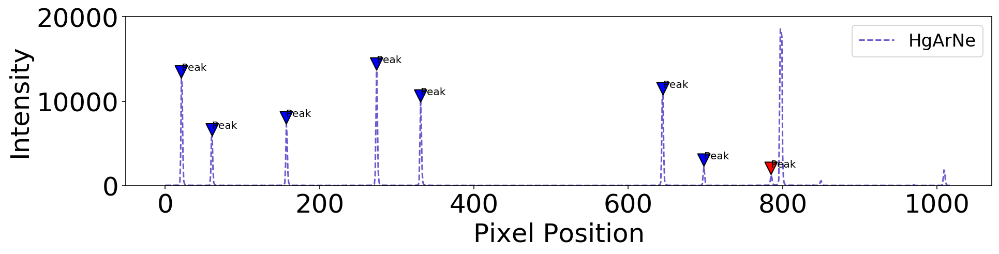

Keep peak at location 785? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


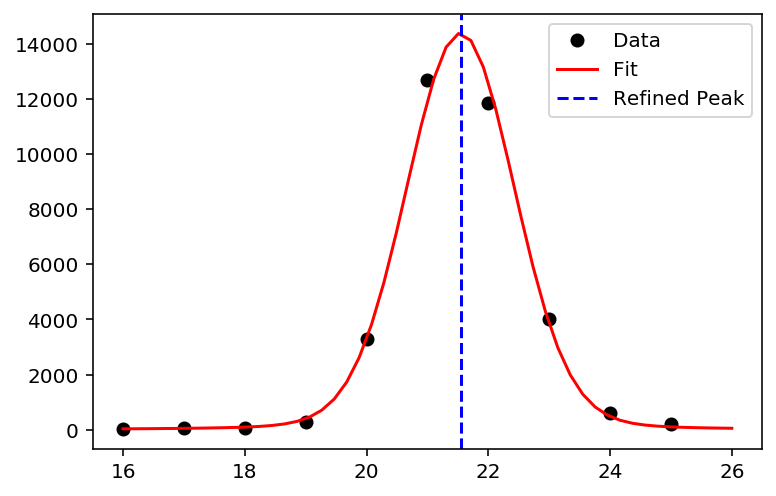

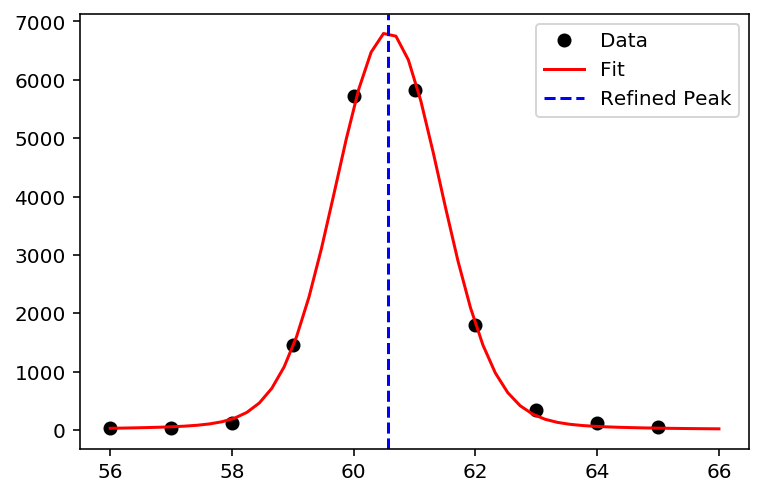

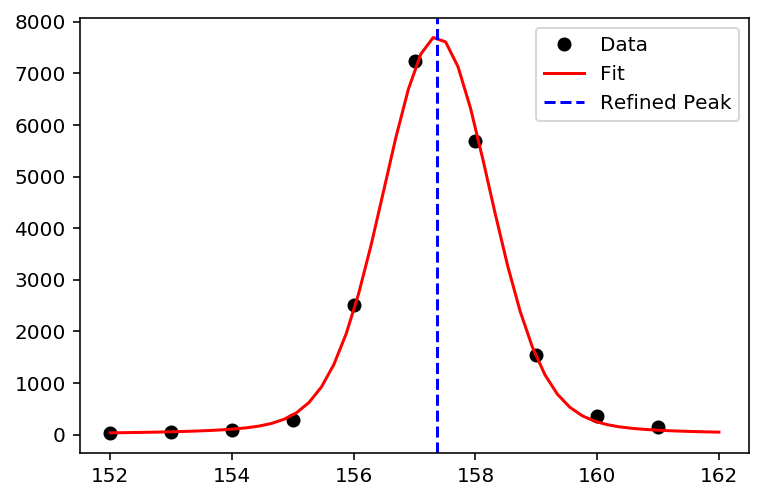

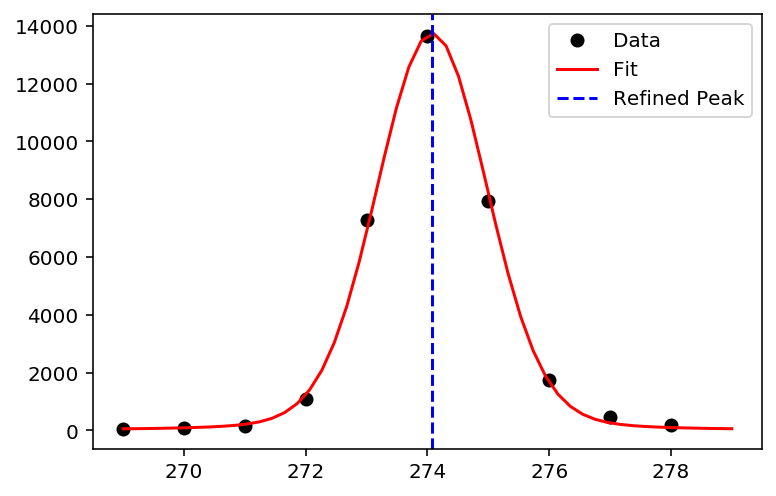

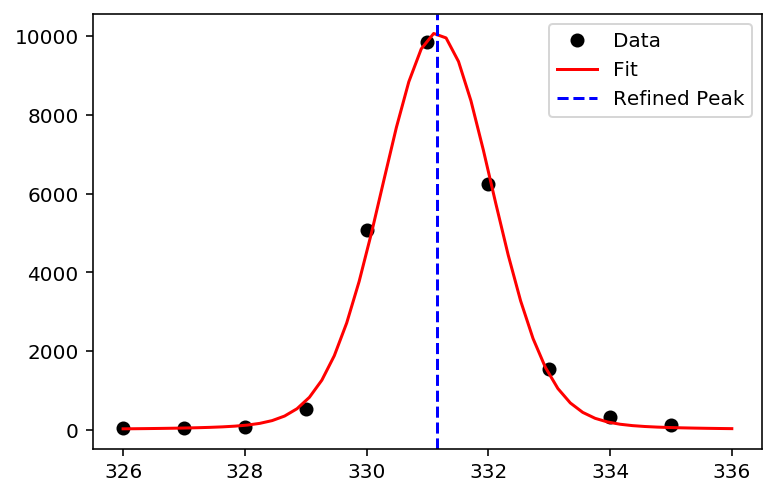

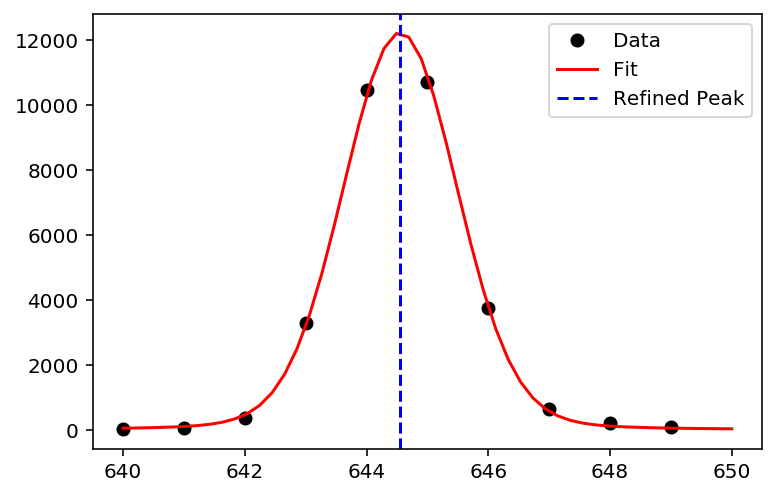

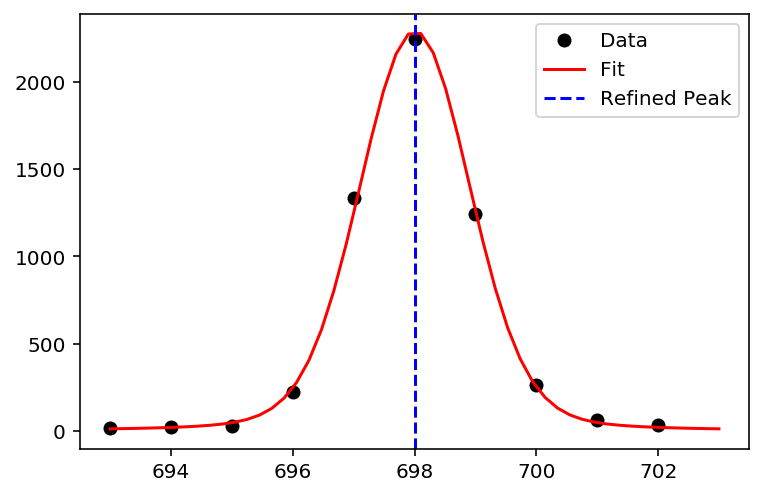

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


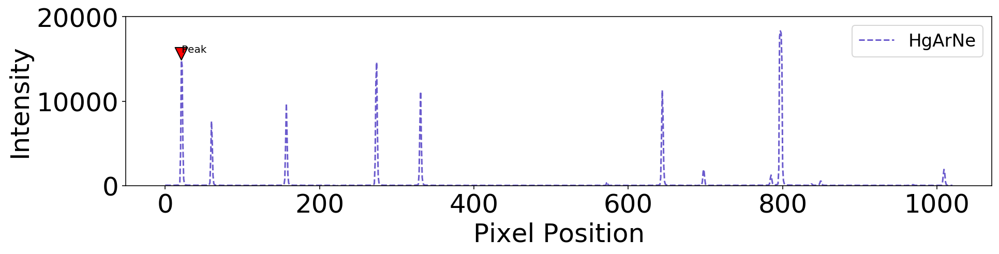

Keep peak at location 21? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


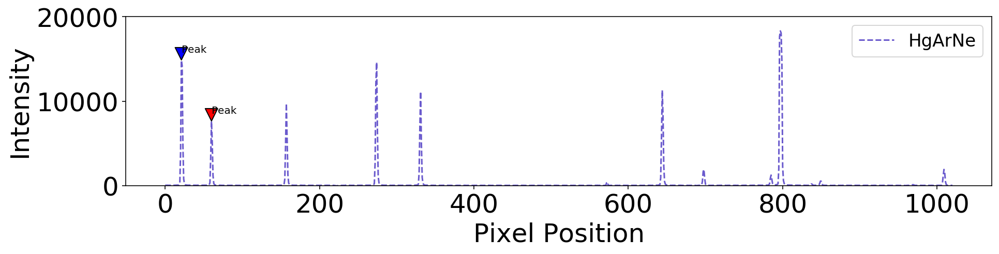

Keep peak at location 60? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


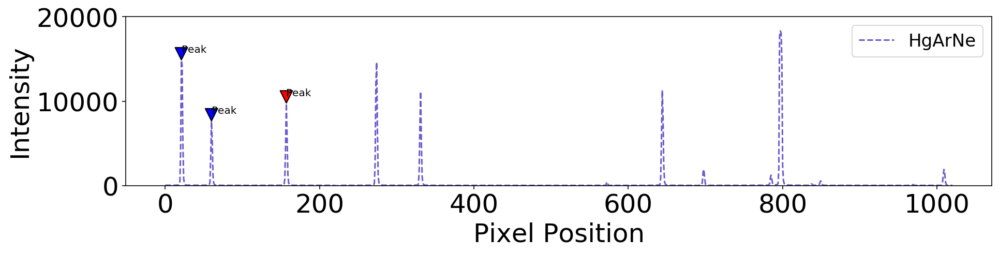

Keep peak at location 157? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


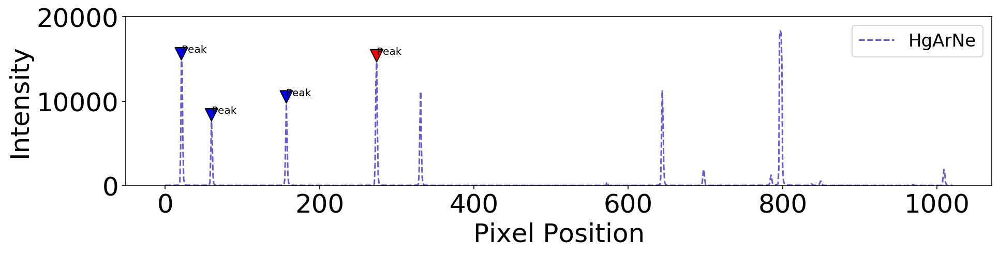

Keep peak at location 274? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


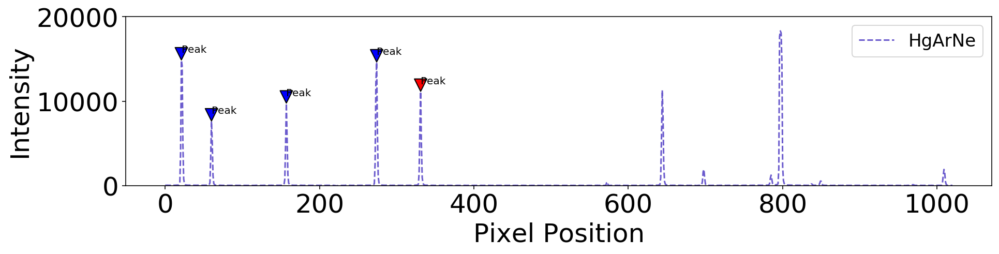

Keep peak at location 331? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


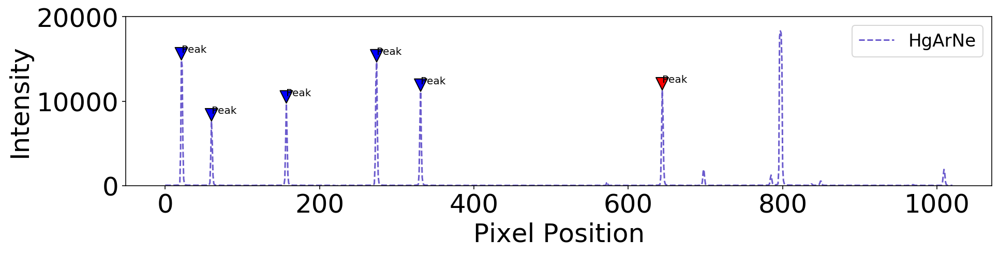

Keep peak at location 644? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


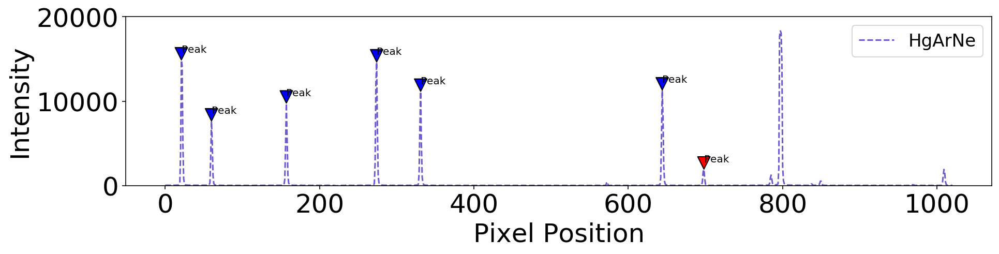

Keep peak at location 698? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


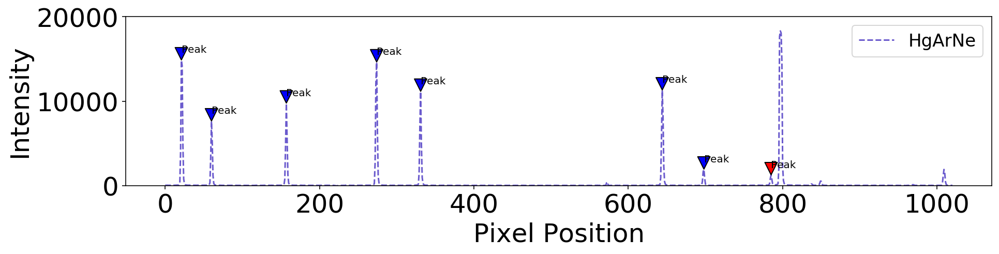

Keep peak at location 785? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


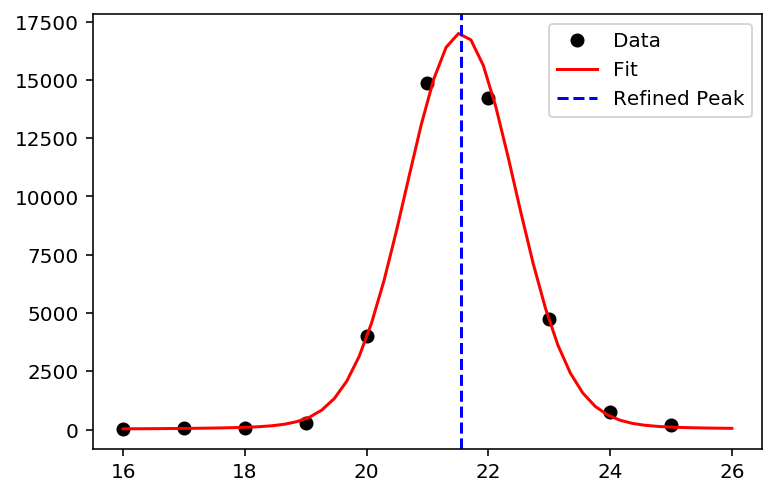

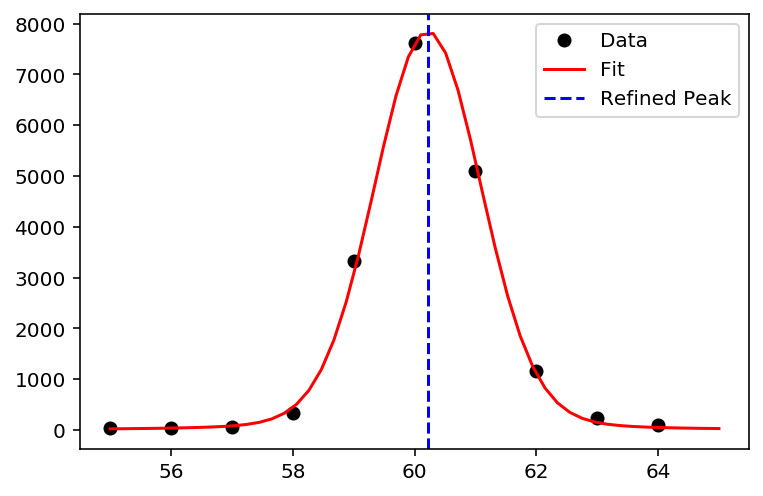

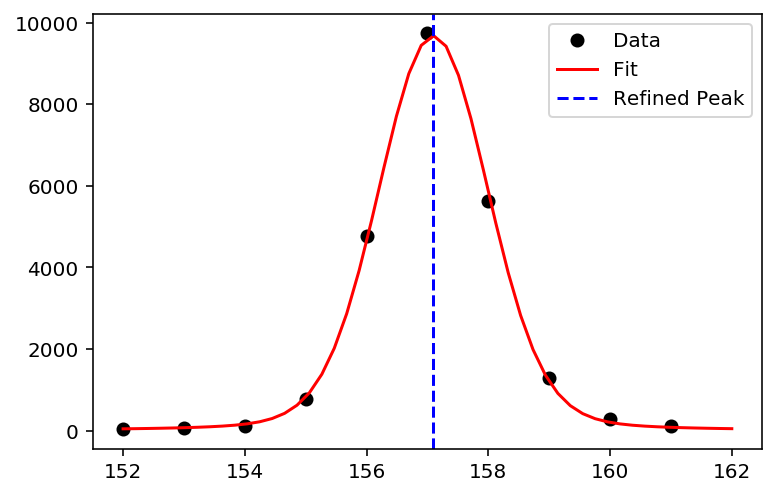

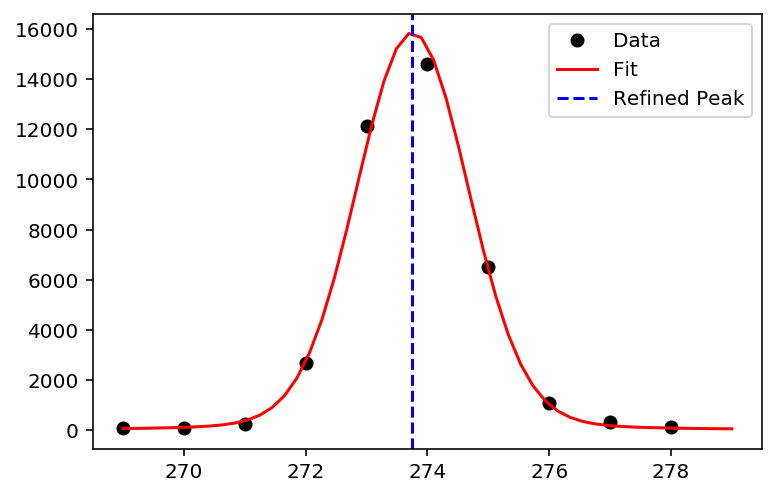

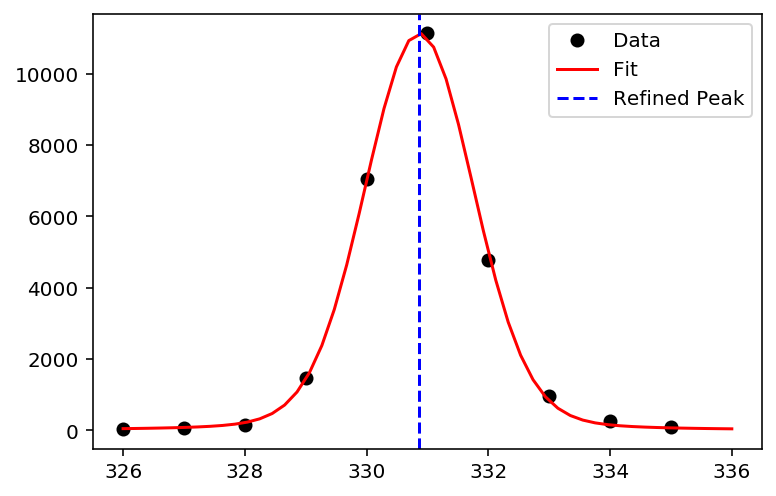

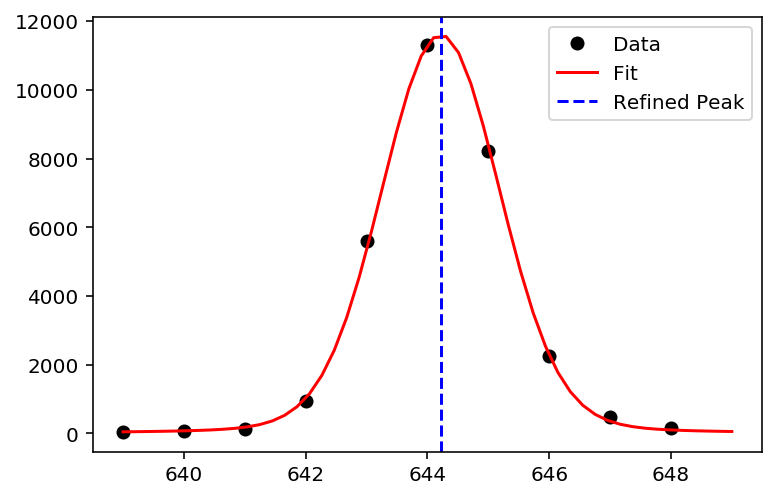

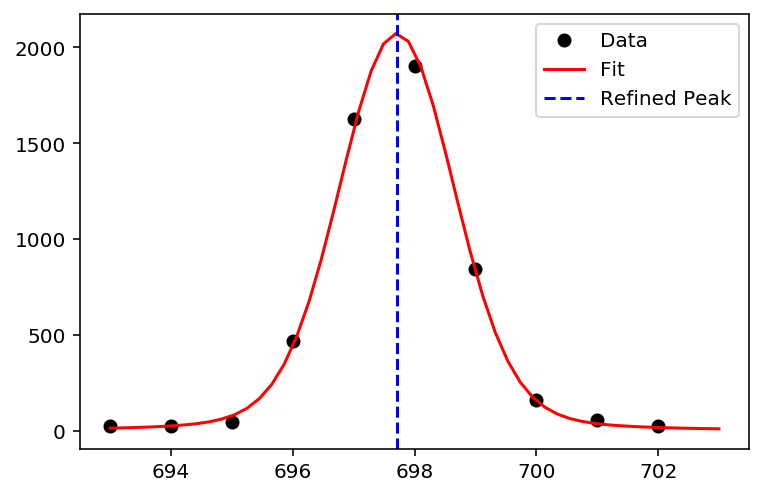

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


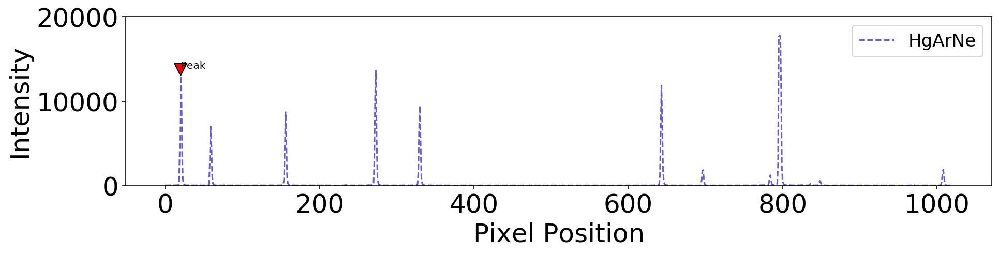

Keep peak at location 20? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


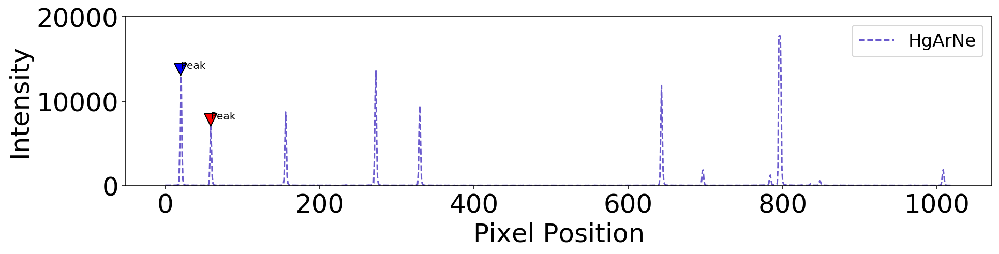

Keep peak at location 59? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


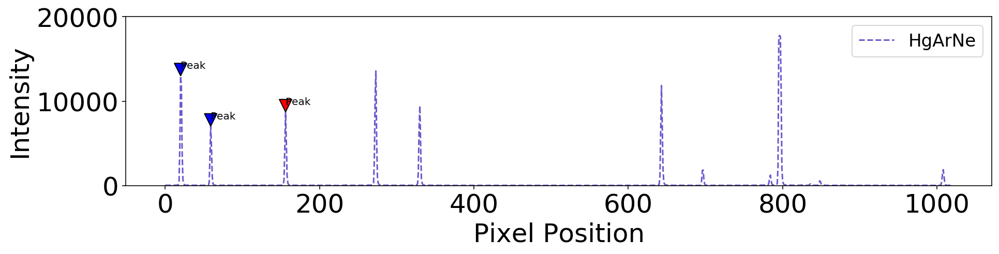

Keep peak at location 156? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


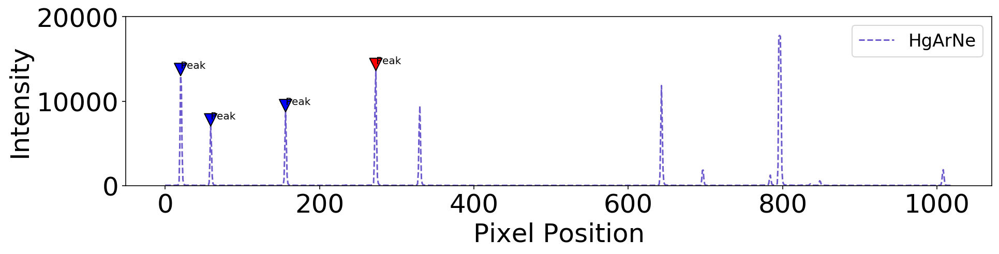

Keep peak at location 273? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


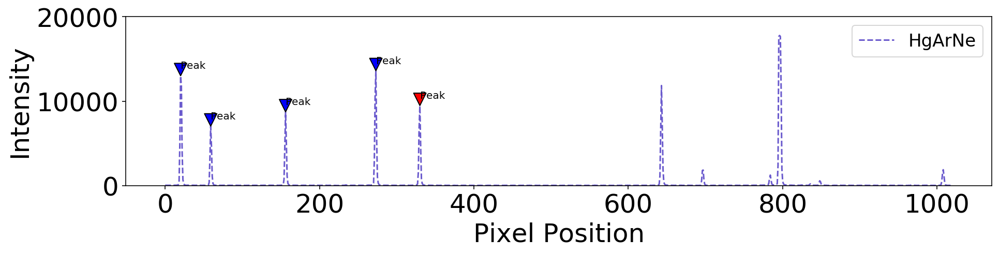

Keep peak at location 330? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


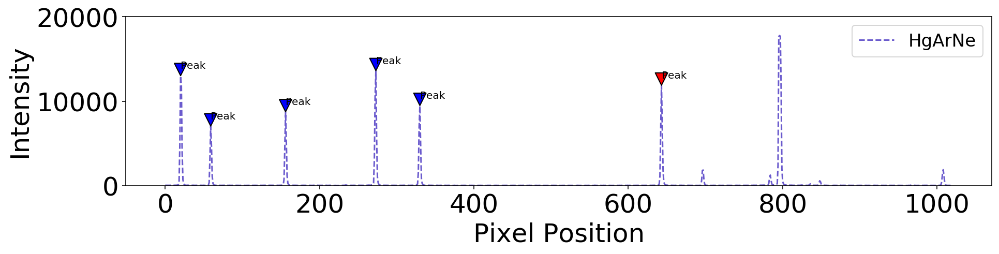

Keep peak at location 643? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


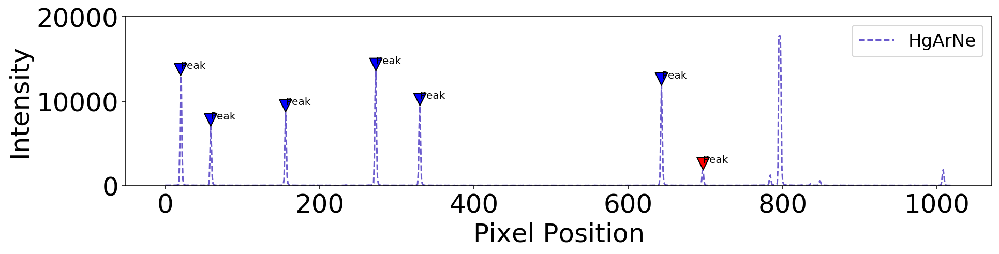

Keep peak at location 697? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


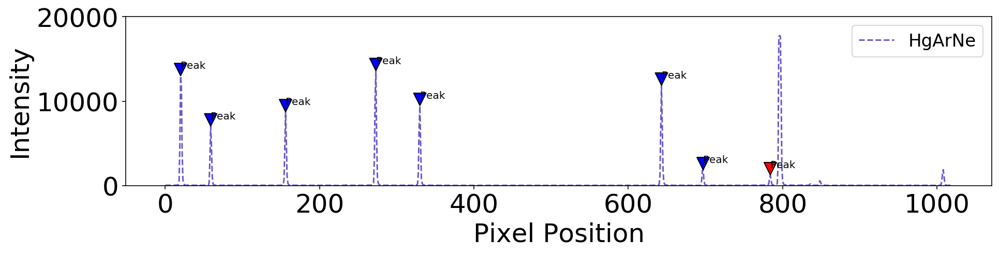

Keep peak at location 784? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


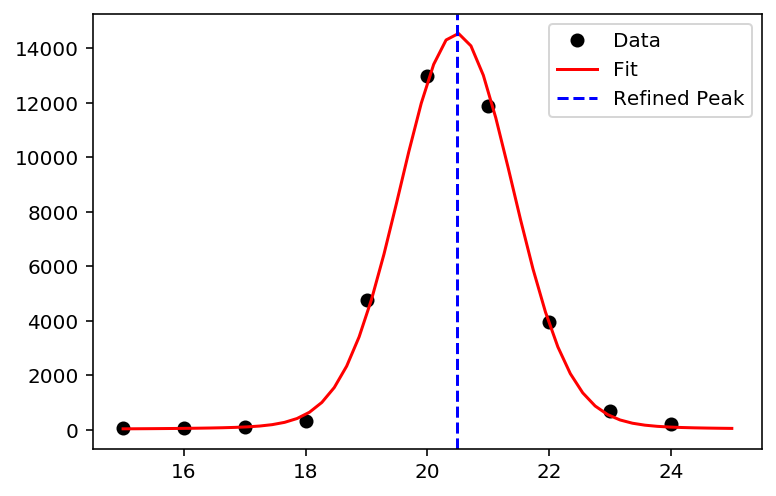

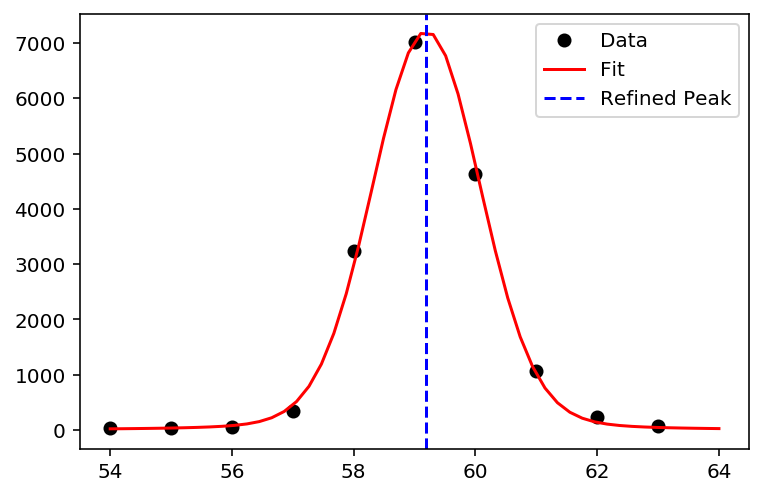

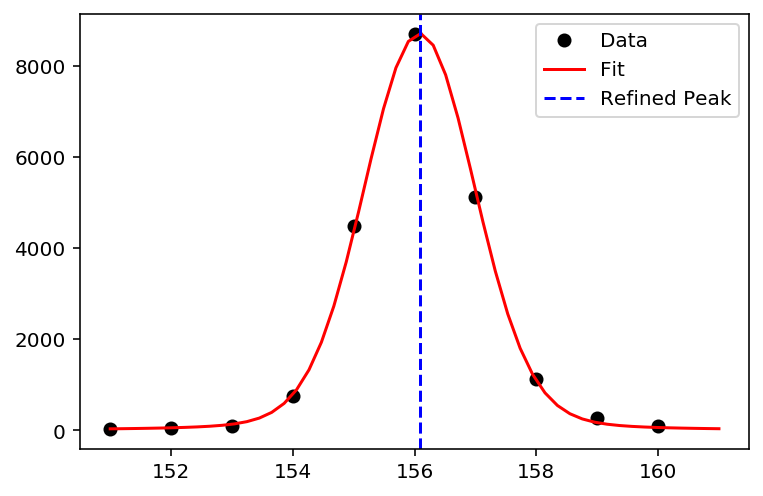

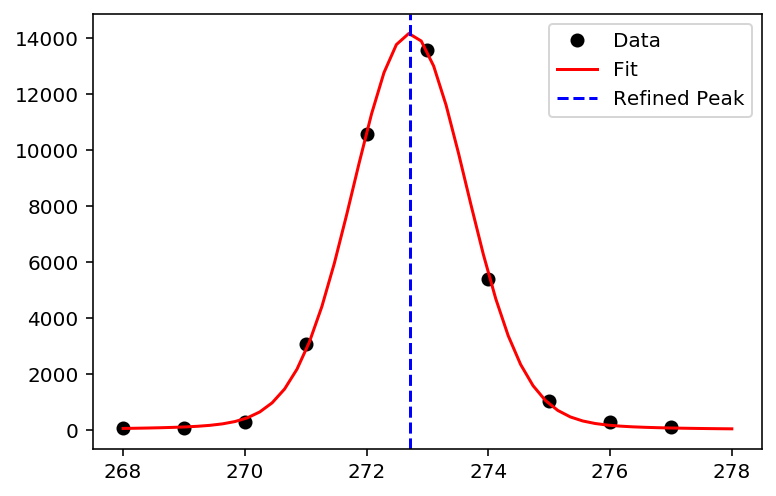

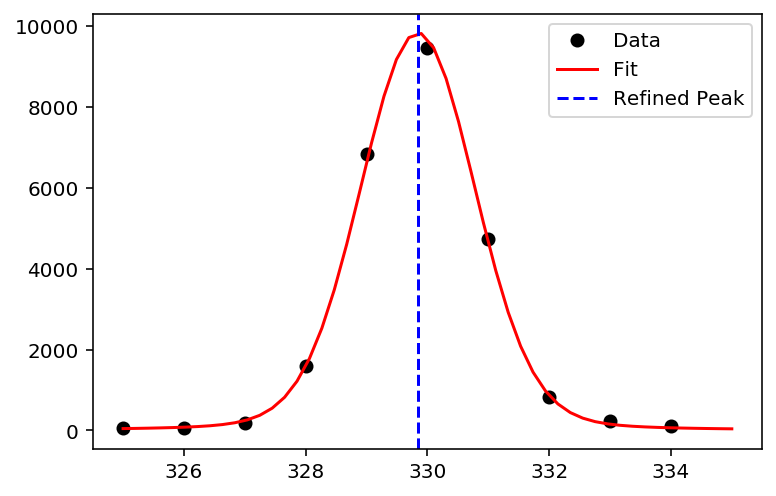

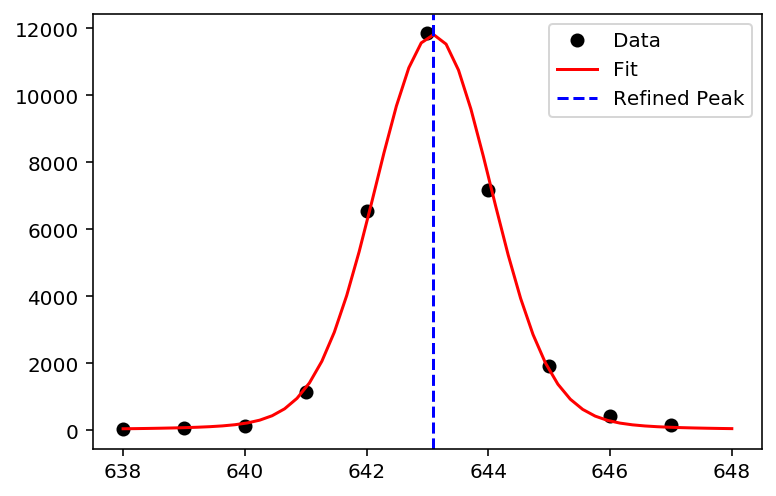

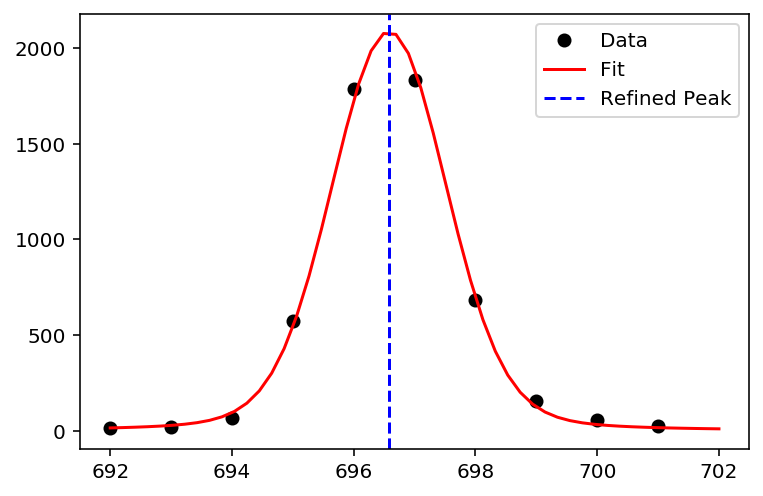

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


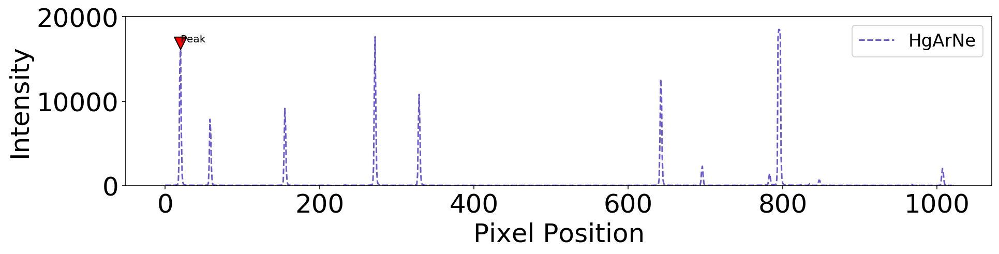

Keep peak at location 20? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


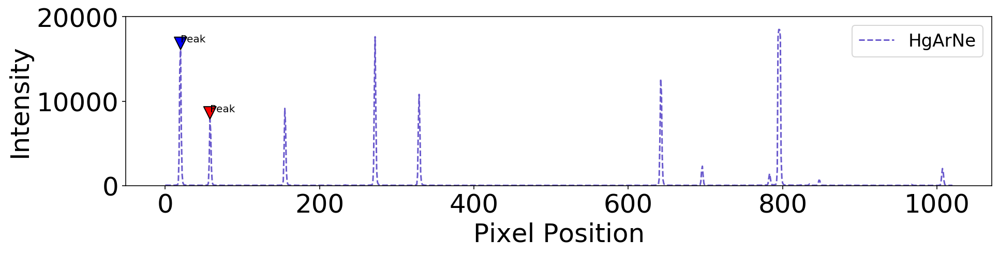

Keep peak at location 58? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


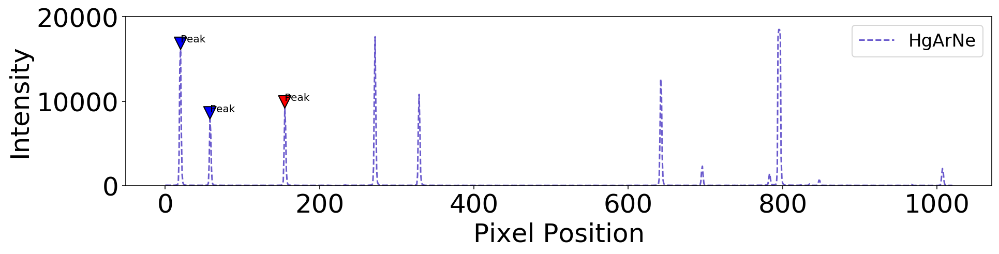

Keep peak at location 155? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


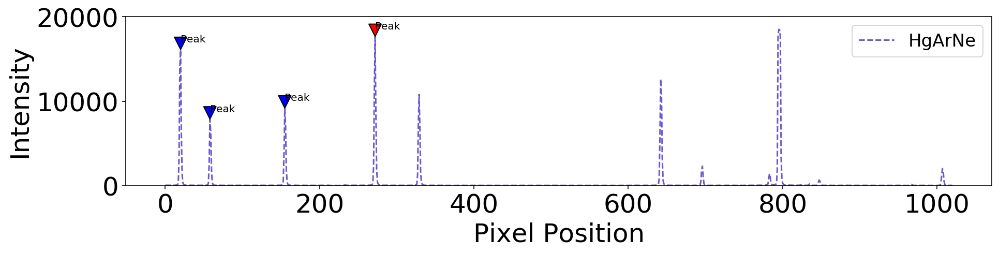

Keep peak at location 272? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


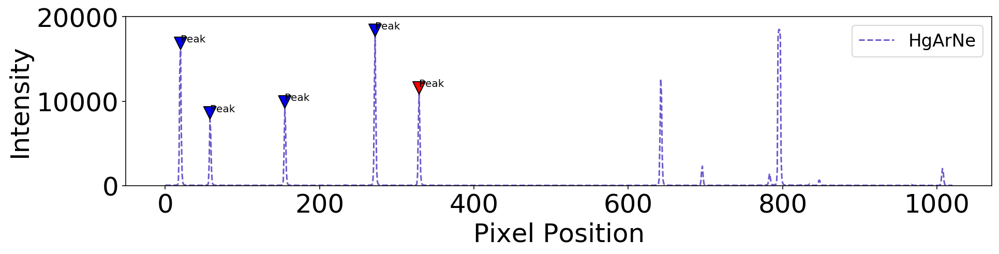

Keep peak at location 329? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


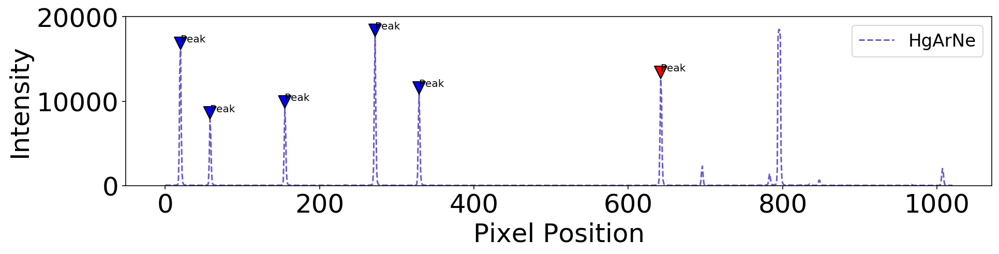

Keep peak at location 642? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


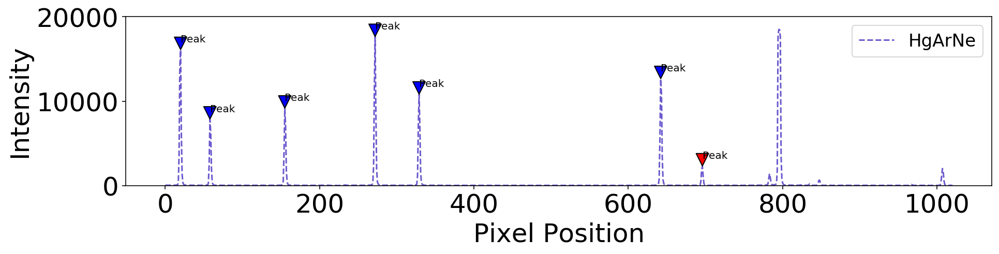

Keep peak at location 696? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


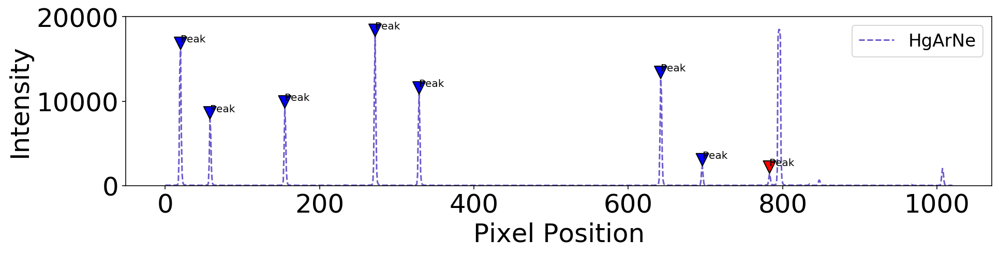

Keep peak at location 783? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


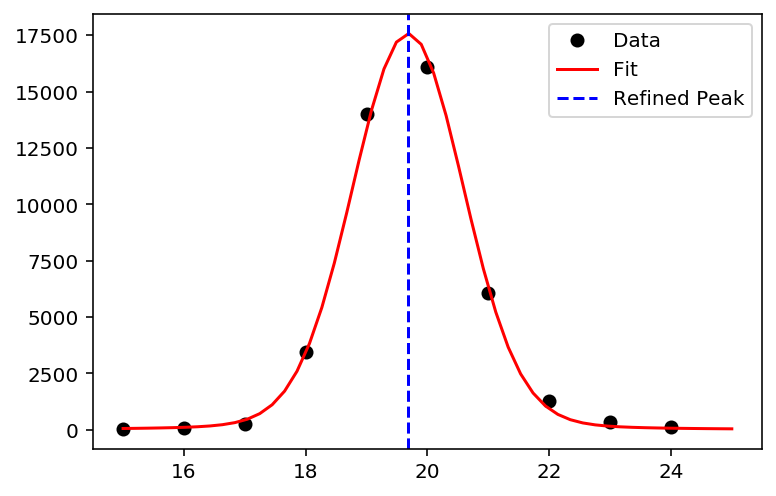

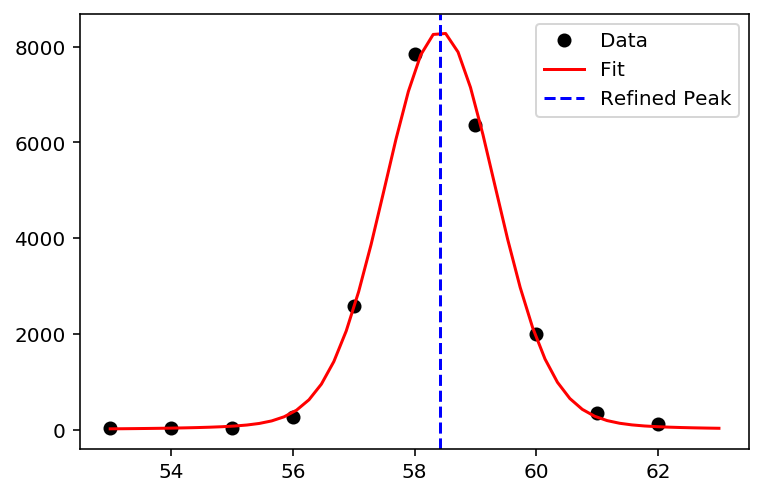

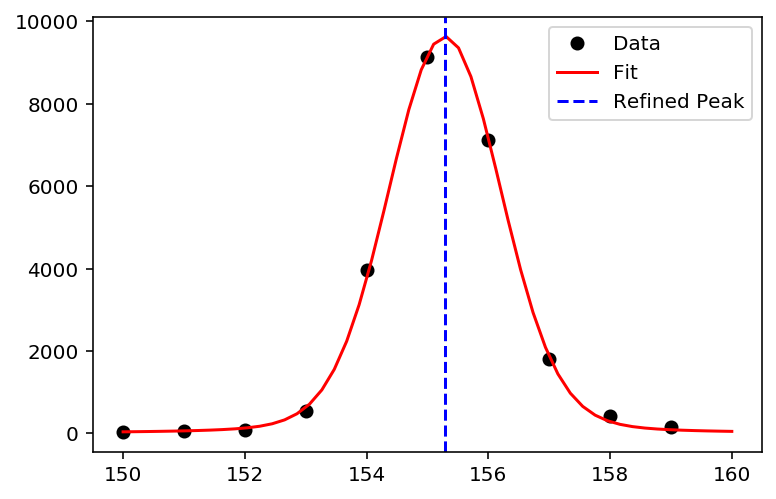

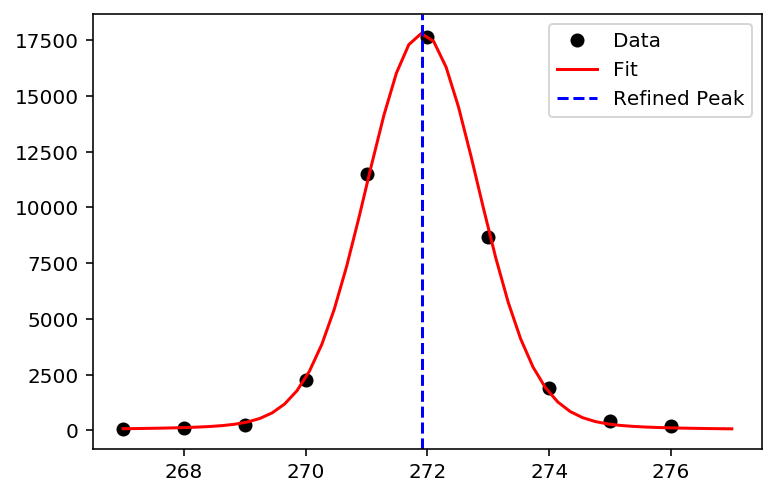

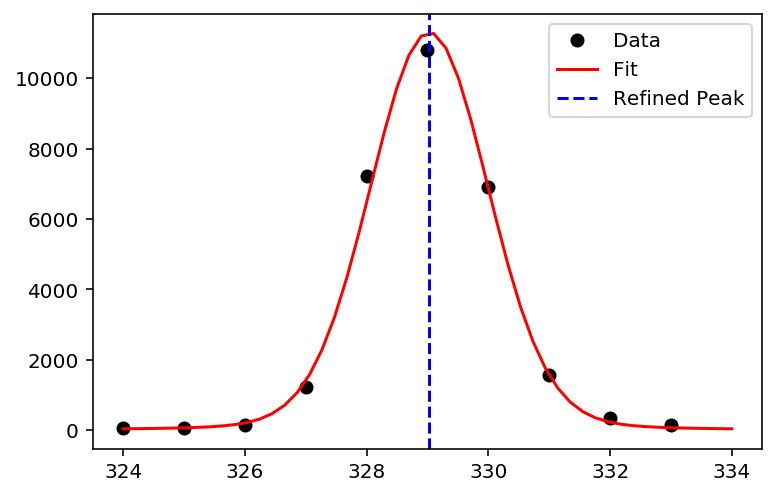

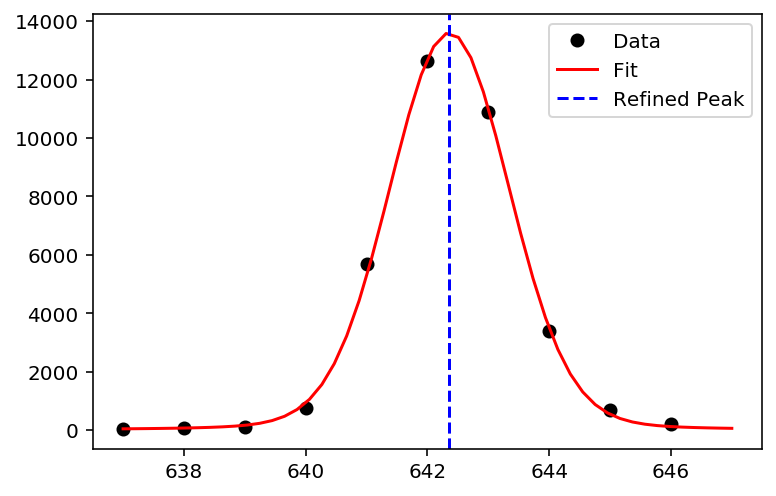

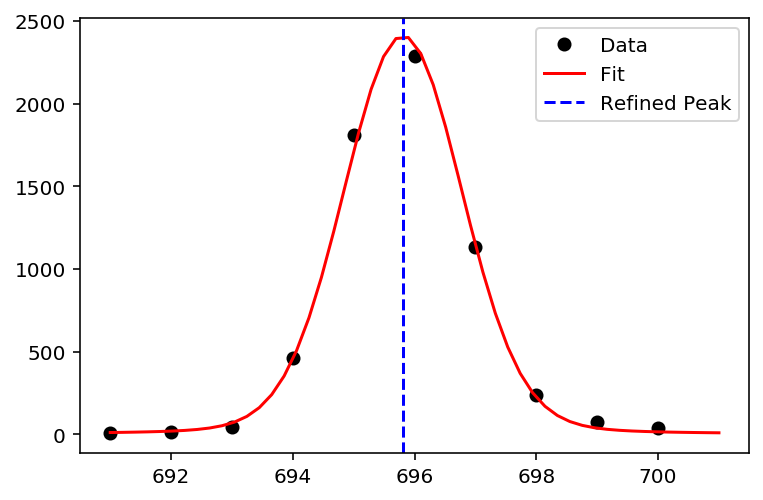

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


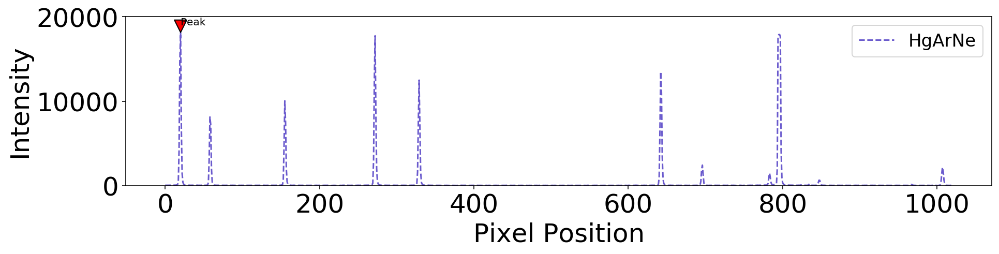

Keep peak at location 20? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


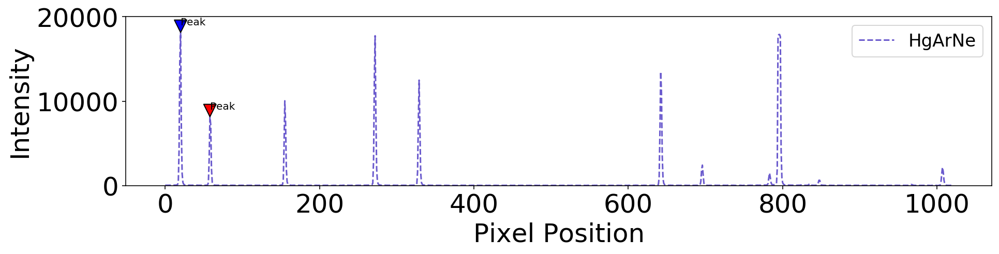

Keep peak at location 58? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


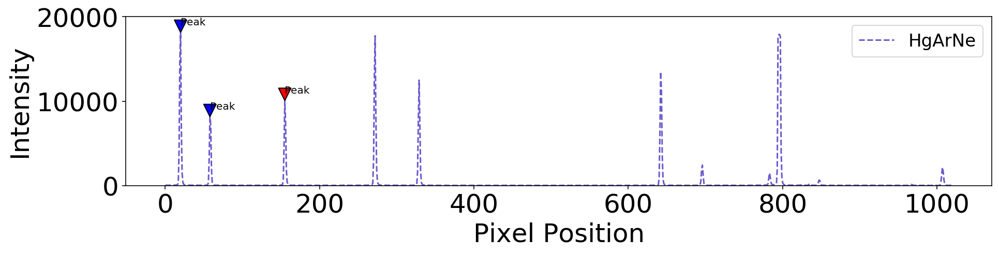

Keep peak at location 155? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


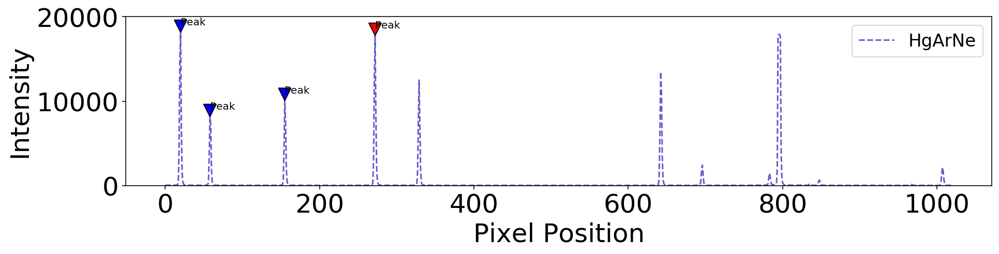

Keep peak at location 272? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


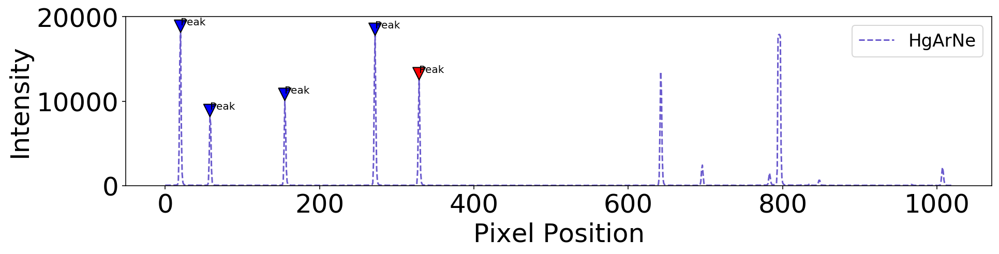

Keep peak at location 329? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


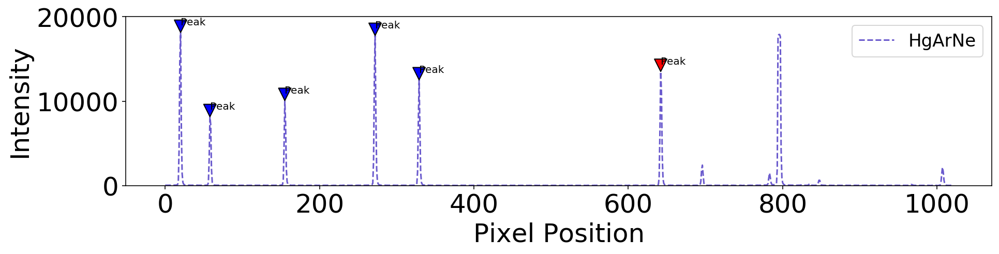

Keep peak at location 642? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


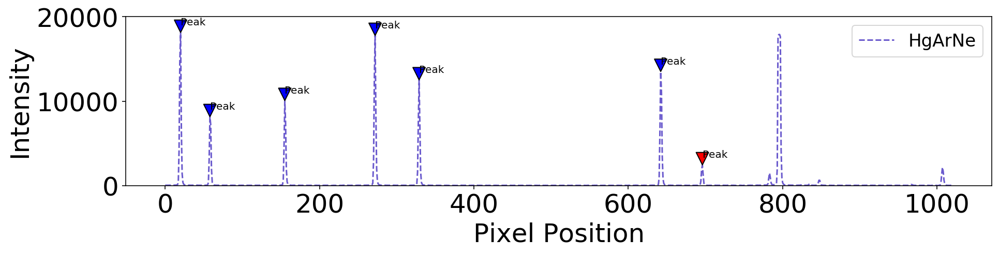

Keep peak at location 696? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


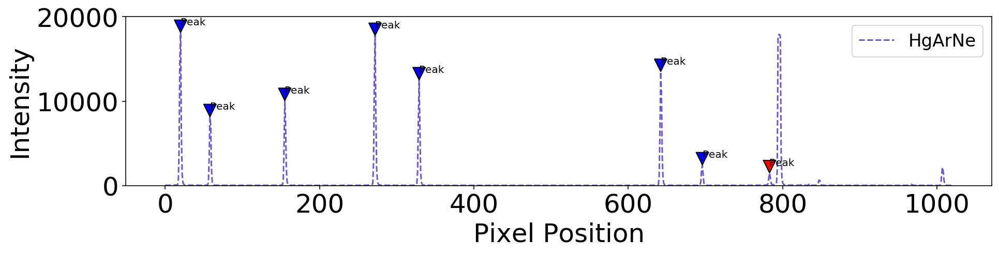

Keep peak at location 783? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


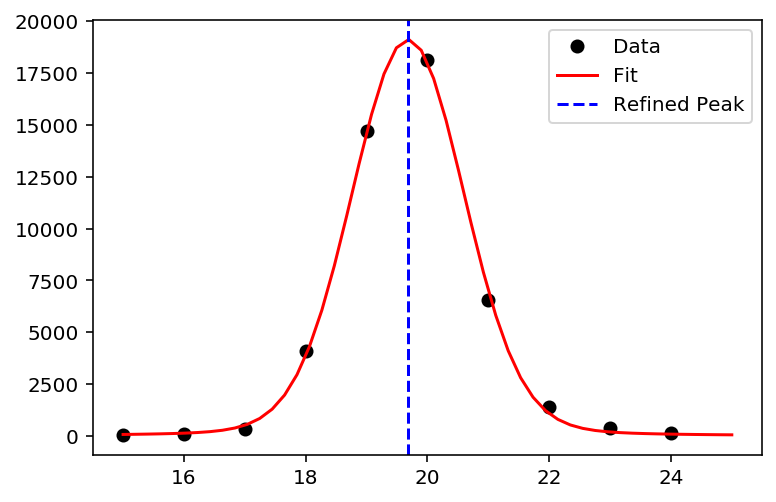

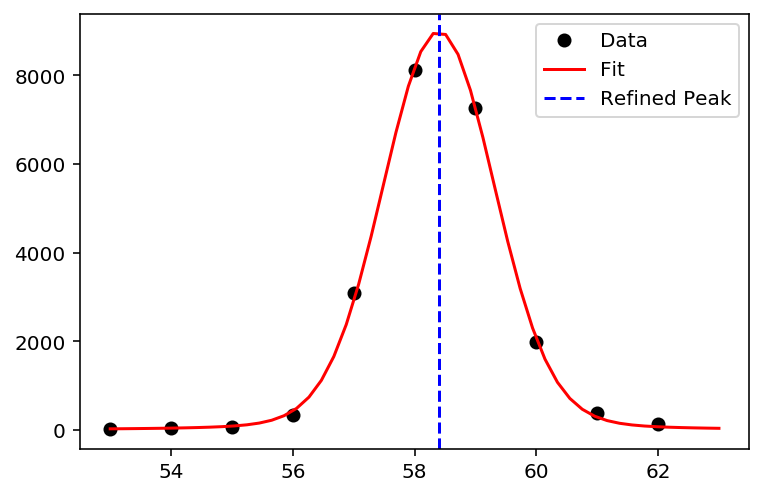

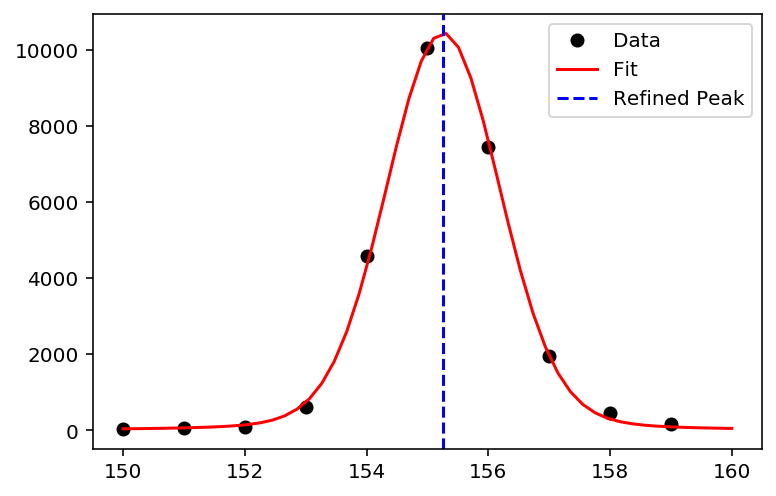

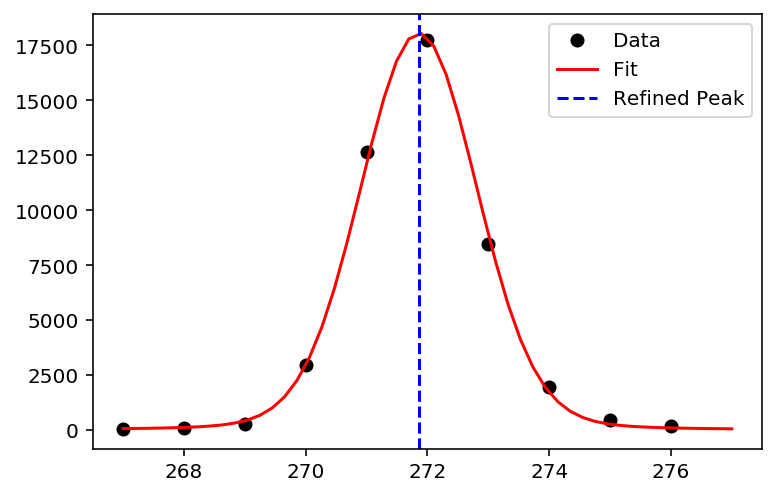

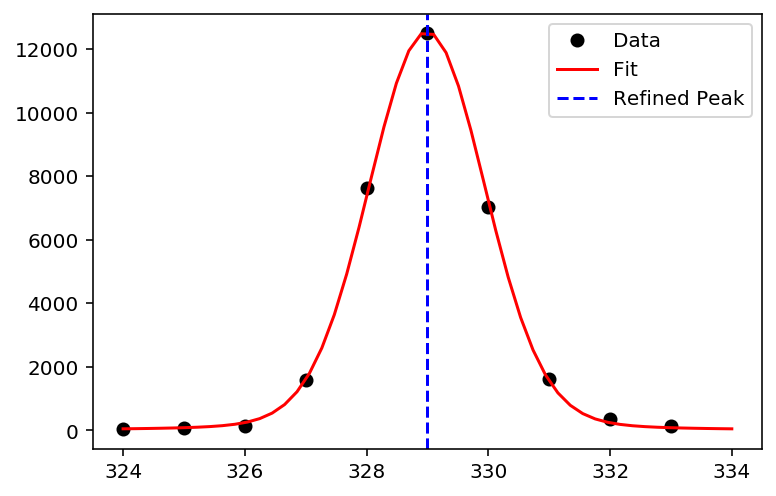

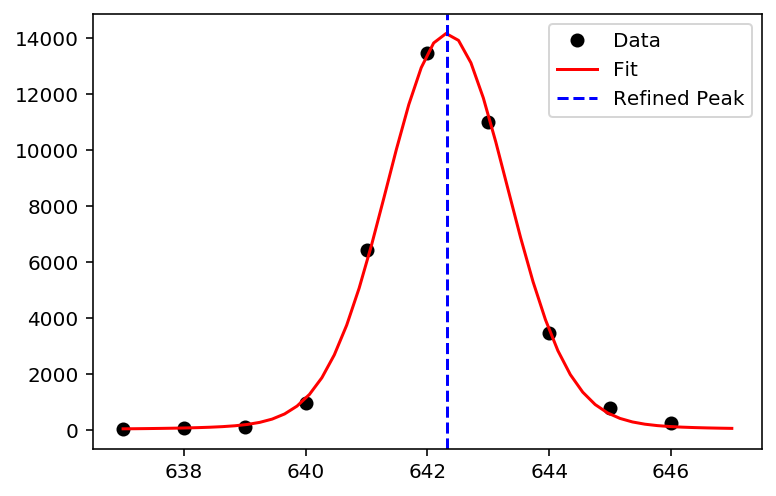

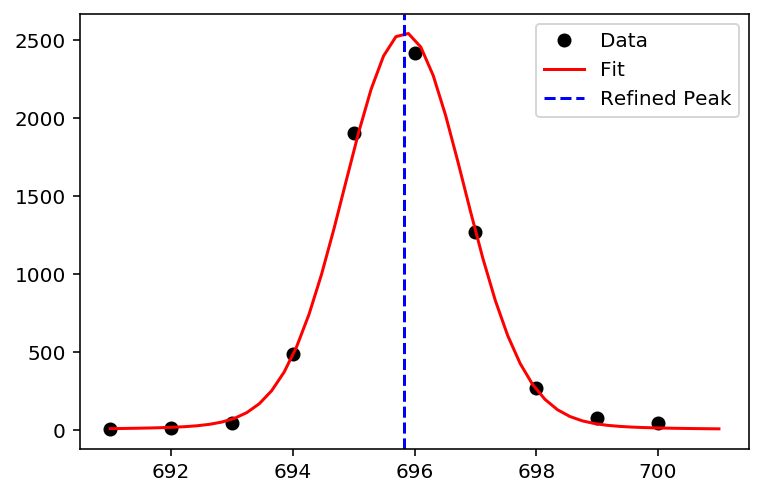

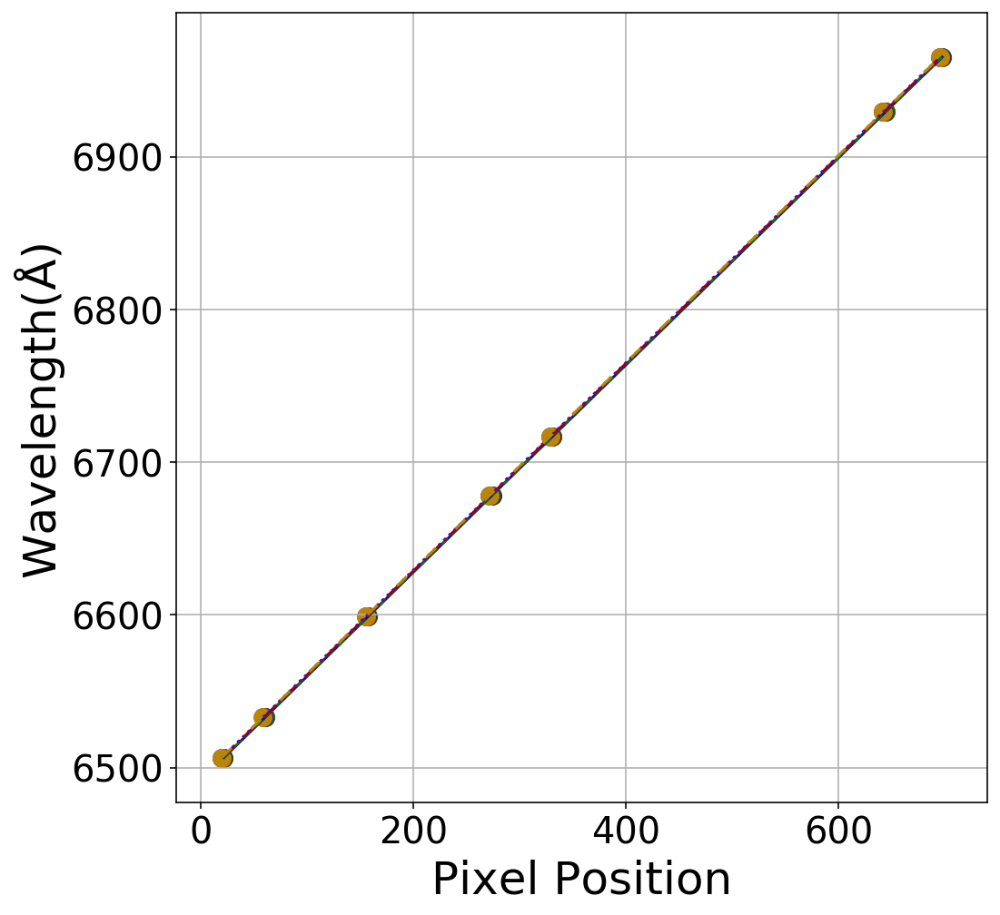

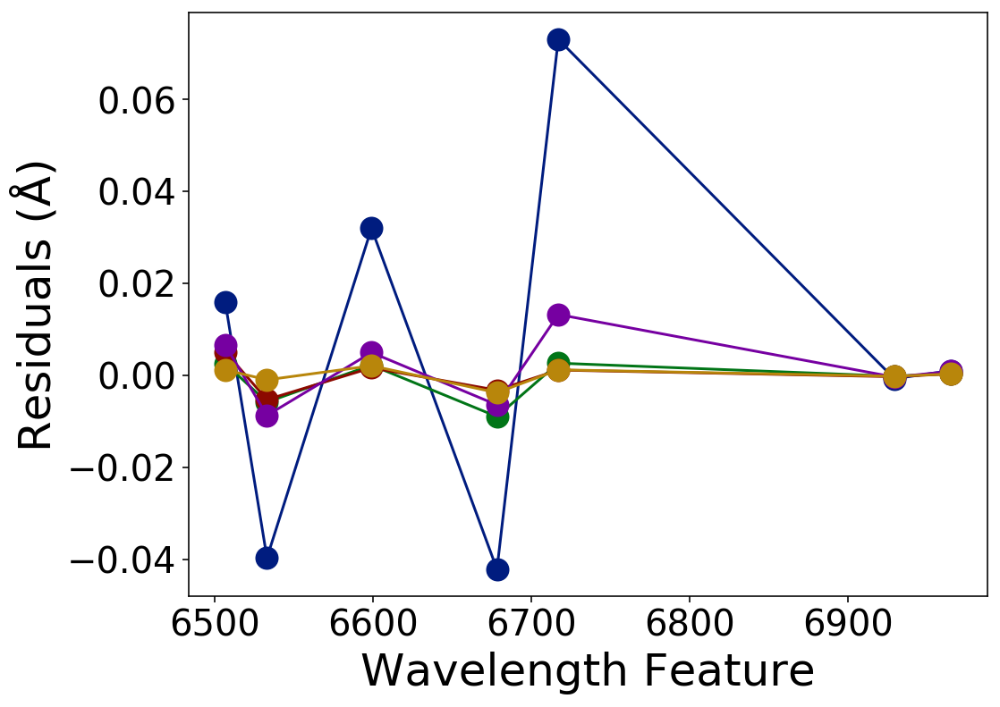

In [20]:
def wavelength_solutions(calibration, data_cu, data_hg, slice_arr, det, height_cu=10,height_hg=600):
    """
    Compute pixel->wavelength solutions using Cu or Hg arcs, or combine both.

    Returns
    -------
    all_solutions : np.ndarray
        2D array (n_slices, spectral_size).
    med_line : np.ndarray
        1D array (spectral_size), the mean solution across slices.
    """
    
    all_solutions = list()
    residuals_list = list()
    features = list()
    uncertainties_list=list()

    if calibration == 'cu':
        pixel_locs, spec_size, x0_error = pixel_locations('cu', data_cu, data_hg, slice_arr,det,height=height_cu)
    
    elif calibration == 'hg':
        pixel_locs, spec_size, x0_error = pixel_locations('hg', data_cu, data_hg, slice_arr,det,height=height_hg)

    
    elif calibration == 'both':
        combined_locs = list()
        pixel_locs_1,spec_size, x0_error1 = pixel_locations('cu', data_cu, data_hg, slice_arr,det,height=height_cu)
        pixel_locs_2,spec_size, x0_error2 = pixel_locations('hg', data_cu, data_hg, slice_arr, det,height=height_hg)
        
        for idx, element in enumerate(pixel_locs_1):
            
            combined = np.concatenate((element,pixel_locs_2[idx]))
            combined_locs.append(combined)
        
        pixel_locs = np.array(combined_locs) 
        
        
    are_same_size = len(set(map(len, pixel_locs))) == 1
    
    if not are_same_size:
        max_len = max(len(subarray) for subarray in pixel_locs)
        max_arr = np.array([arr for arr in pixel_locs if len(arr) == max_len])
        med_array = np.median(max_arr, axis=0)
        new_locs = [process_subarray(subarray, med_array,max_len) for subarray in pixel_locs]
        pixel_locs = new_locs
        
    detector_wavelength_params = create_meta_data(det, pixel_refernces=pixel_locs)
    
    line_styles = ['-', '--', '-.', ':', (0, (5, 10))]
    plt.figure(figsize=(8, 8))
    for index,pixels in enumerate(detector_wavelength_params['pixel_refernces']):
        weights = 1/x0_error[index]
        
        coeffs,covariance_matrix = np.polyfit(pixels,detector_wavelength_params['Reference Wavelengths'],
                                deg=5, w=weights,cov=True)
        
        
        pix_to_wave=pixel_to_wavelength(np.arange(0,spec_size,1),coeffs)
        all_solutions.append(pix_to_wave)
        
        plt.scatter(pixels, detector_wavelength_params['Reference Wavelengths'],s=90)
        
        y =  pixel_to_wavelength(pixels,coeffs)
        

        
        residuals = detector_wavelength_params['Reference Wavelengths'] - y
        residuals_list.append(residuals)
        features.append(detector_wavelength_params['Reference Wavelengths'])
        
        plt.plot(pixels,y,linestyle=line_styles[index])
    
    all_solutions = np.array(all_solutions)

    
    med_line = np.mean(all_solutions, axis=0)

    plt.xlabel('Pixel Position', fontsize=25)
    plt.ylabel('Wavelength(Å)', fontsize=25)
    plt.tick_params(axis='both', labelsize=20)
    plt.grid(True)
    plt.show()
    
    all_solutions = np.array(all_solutions)
    
    plt.figure(figsize=(8, 6))
    plt.style.use('seaborn-dark-palette')
    for residuals in residuals_list:
        plt.plot(features[0],residuals, marker = 'o',markersize=12)
        
    
    plt.xlabel('Wavelength Feature', fontsize=25)
    plt.ylabel('Residuals (Å)',fontsize=25)
    plt.tick_params(axis='both', labelsize=20)

    plt.show()
        
    return all_solutions, med_line
                
wav_all, wav_average = wavelength_solutions('hg', cuhear, hghear,refined_slices,det=0)



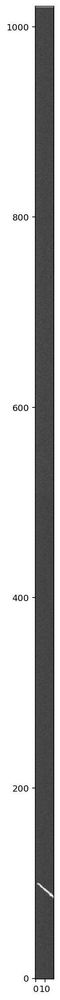

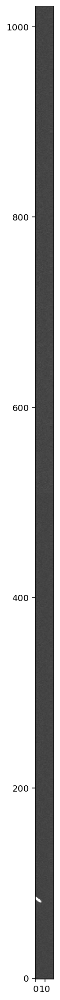

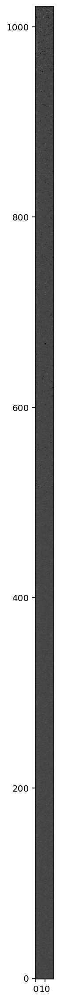

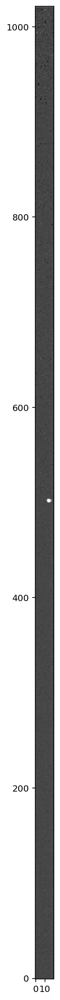

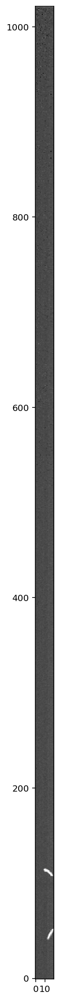

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


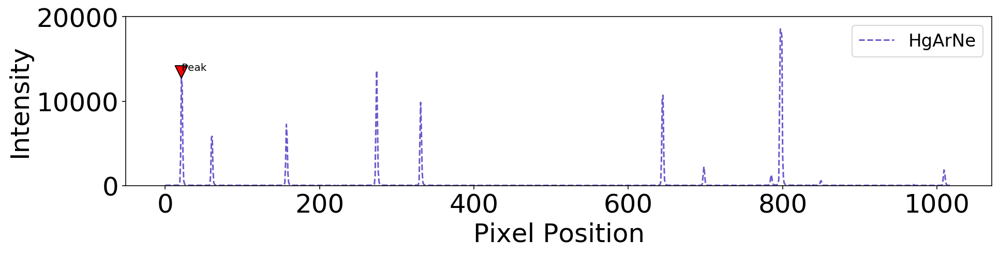

Keep peak at location 21? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


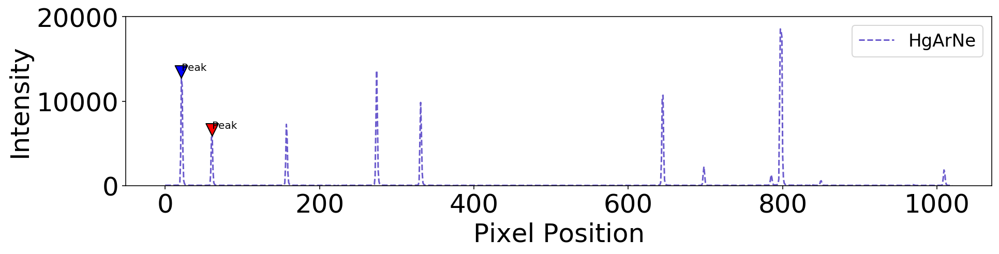

Keep peak at location 61? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


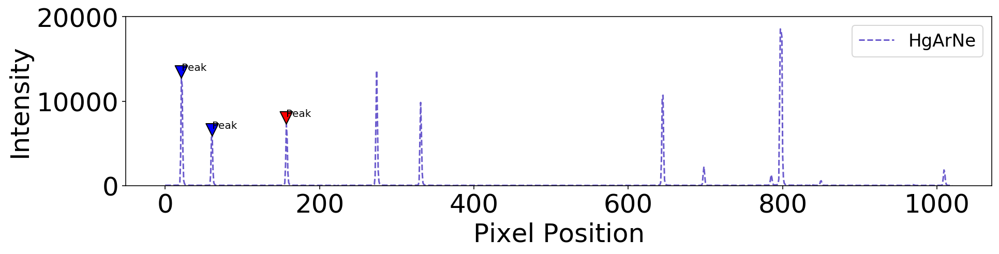

Keep peak at location 157? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


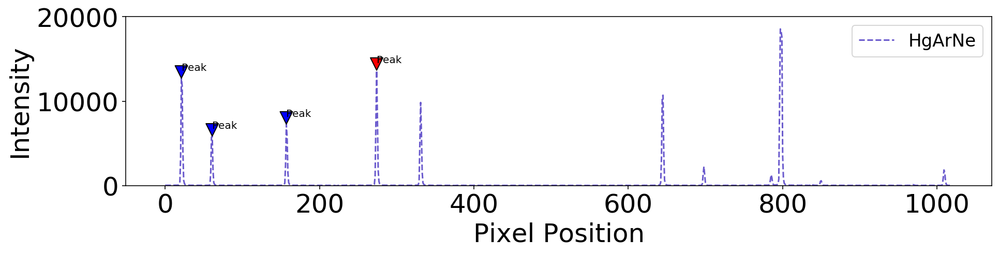

Keep peak at location 274? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


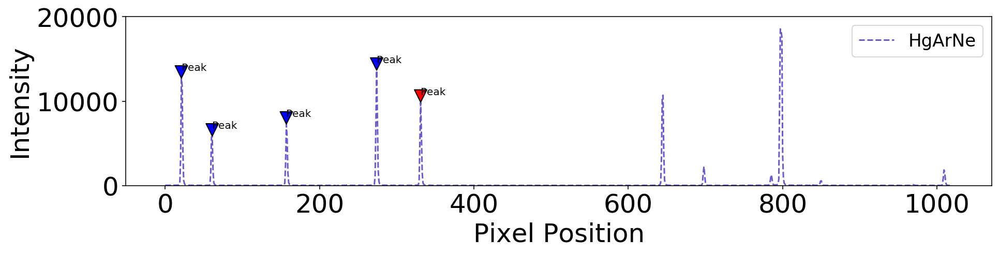

Keep peak at location 331? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


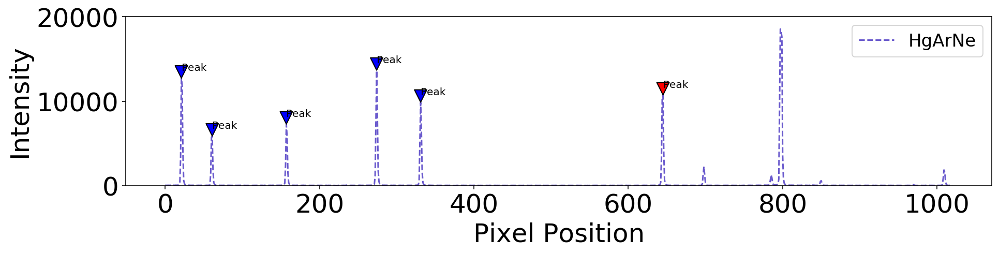

Keep peak at location 645? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


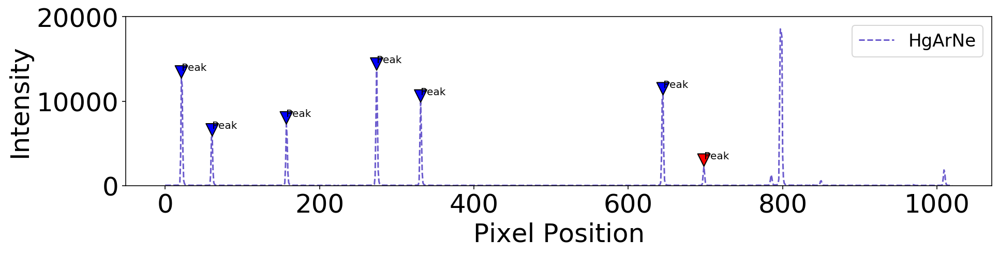

Keep peak at location 698? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


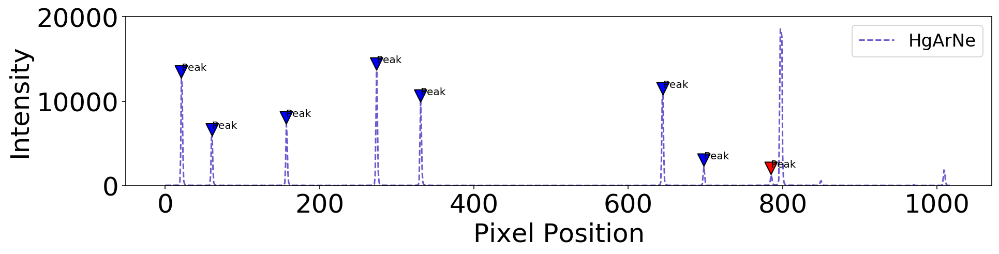

Keep peak at location 785? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


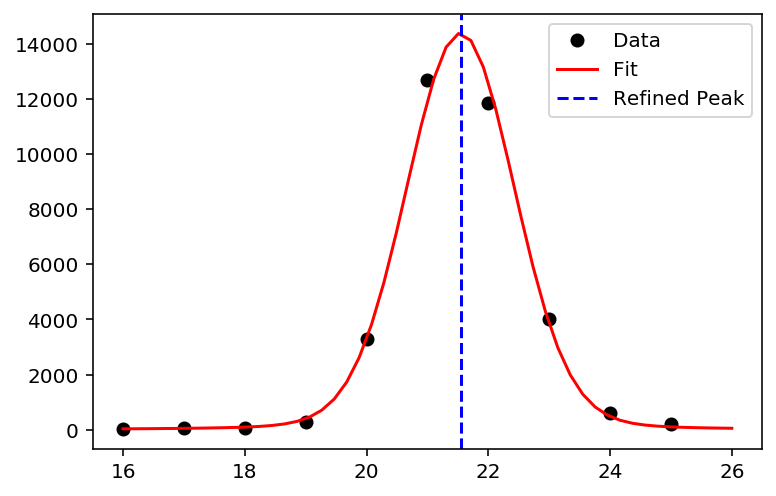

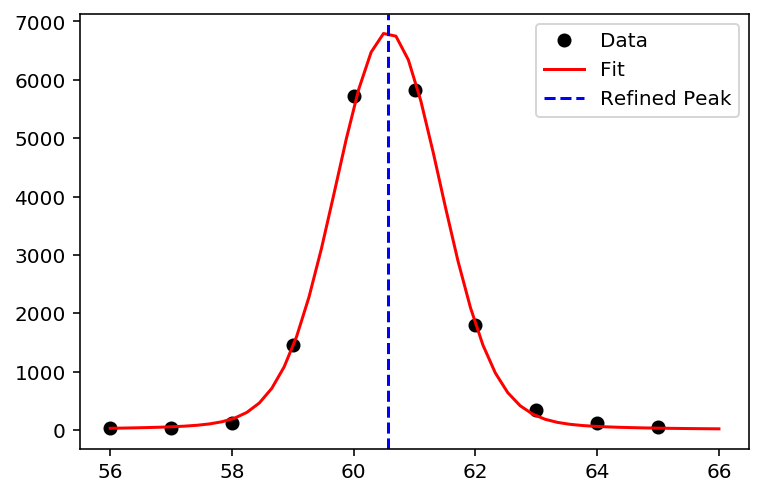

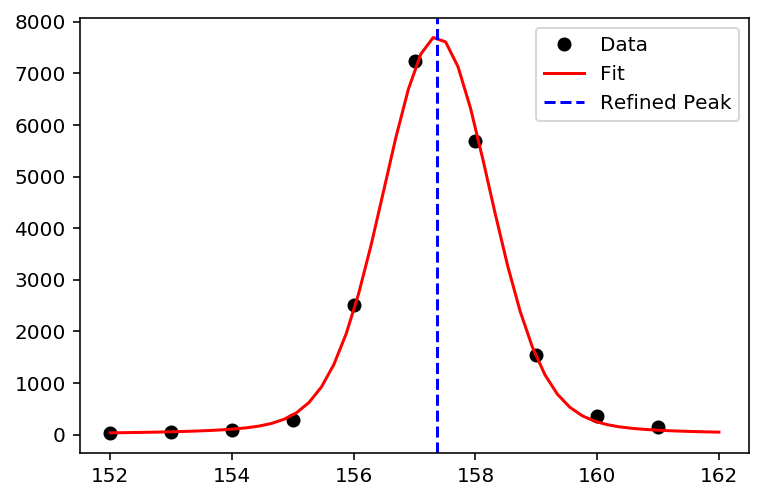

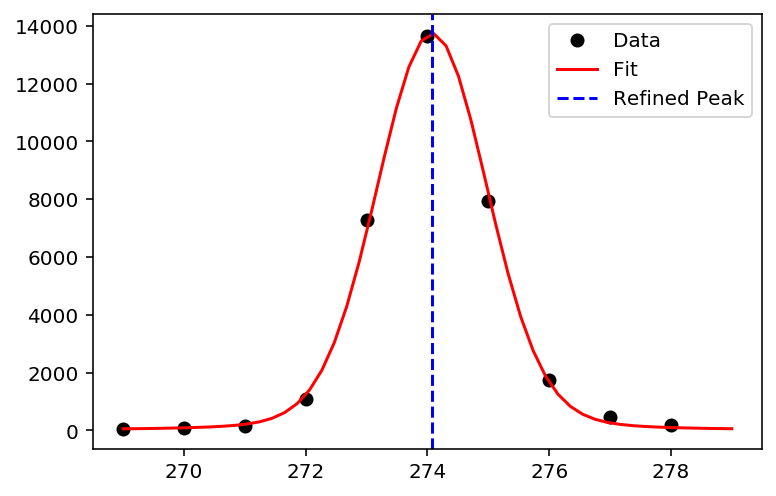

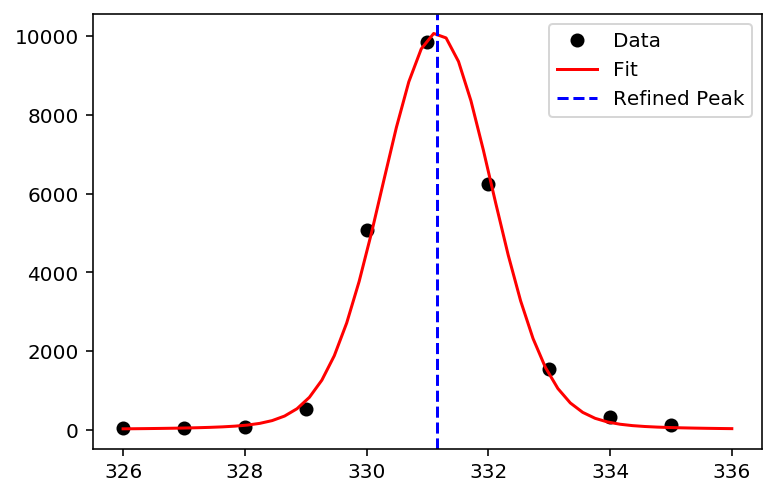

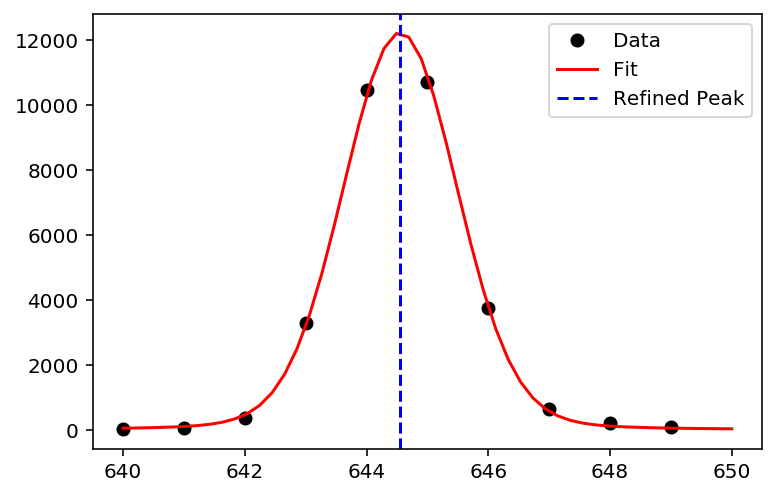

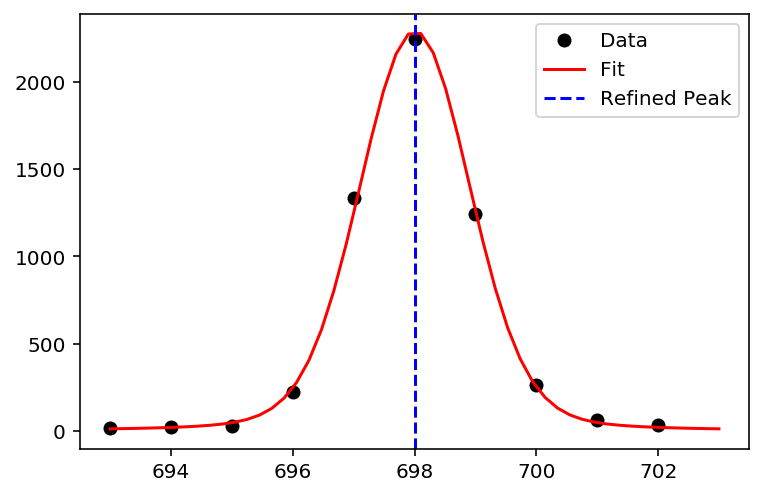

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


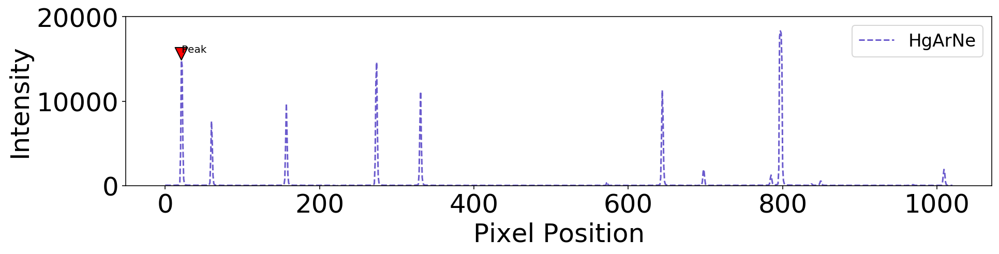

Keep peak at location 21? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


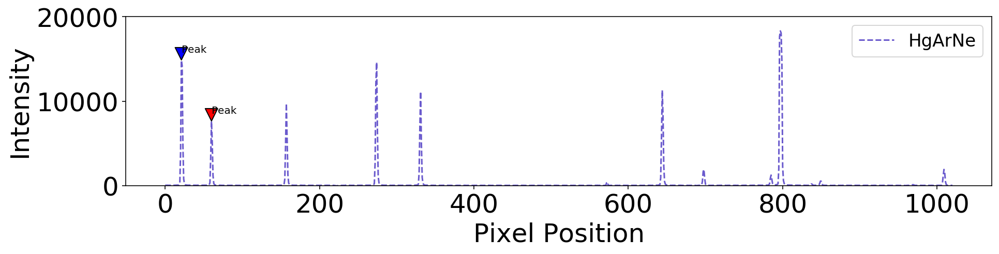

Keep peak at location 60? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


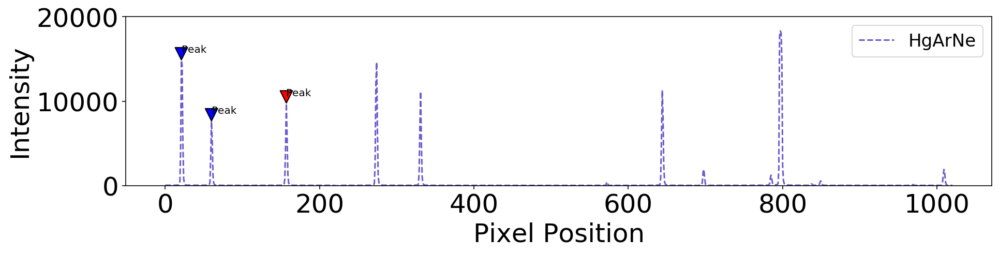

Keep peak at location 157? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


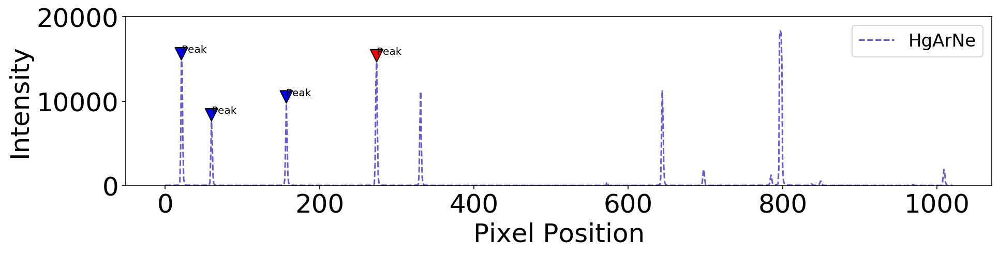

Keep peak at location 274? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


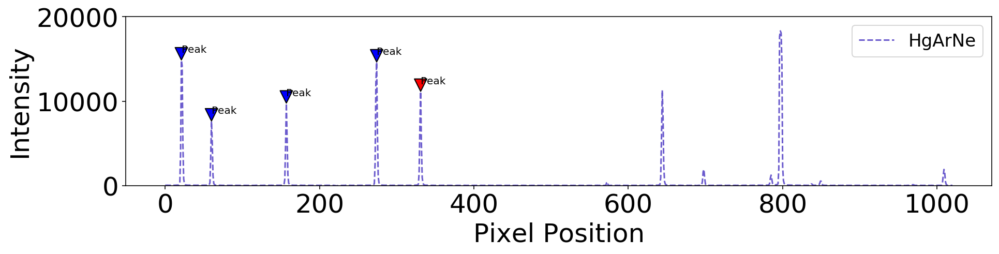

Keep peak at location 331? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


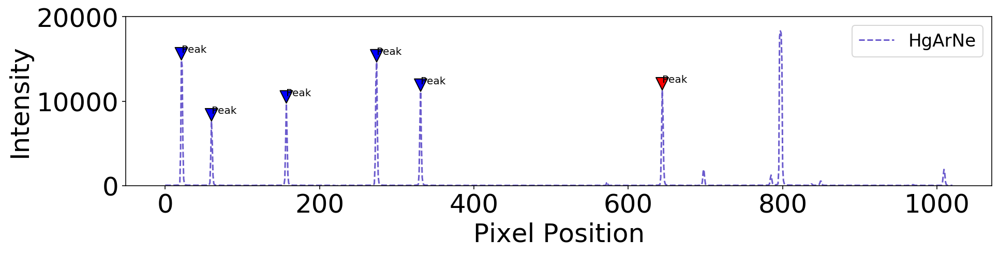

Keep peak at location 644? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


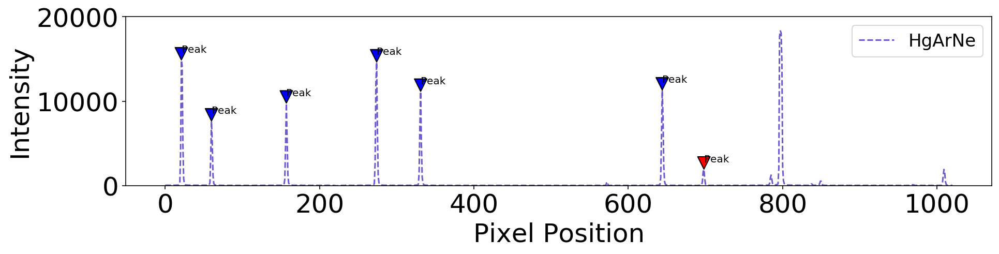

Keep peak at location 698? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


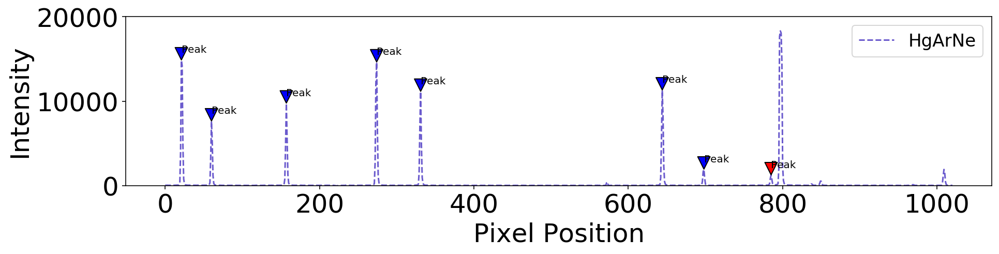

Keep peak at location 785? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


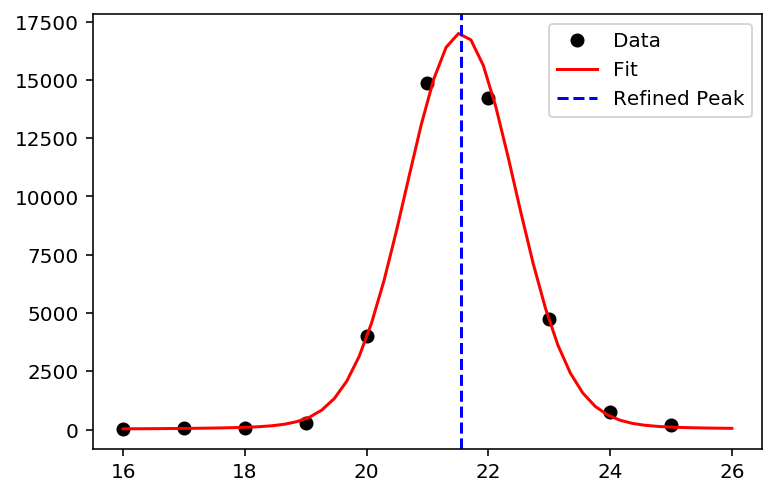

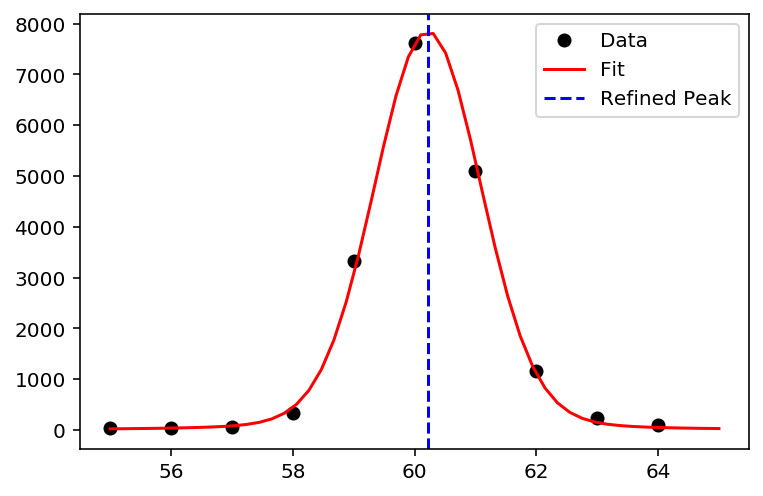

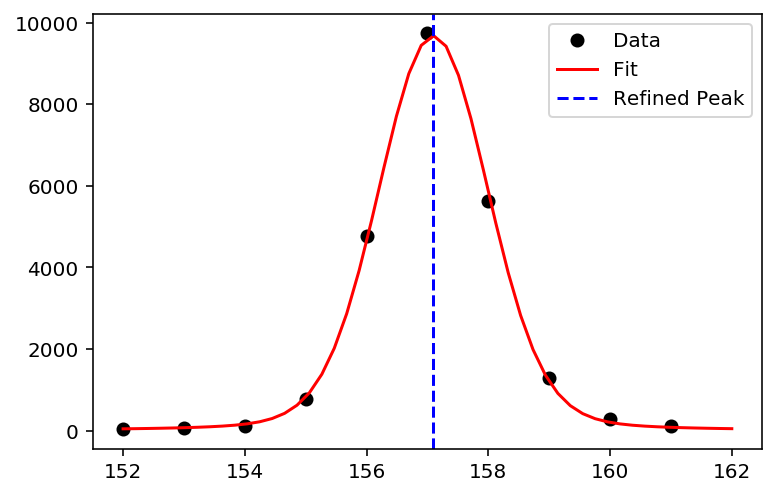

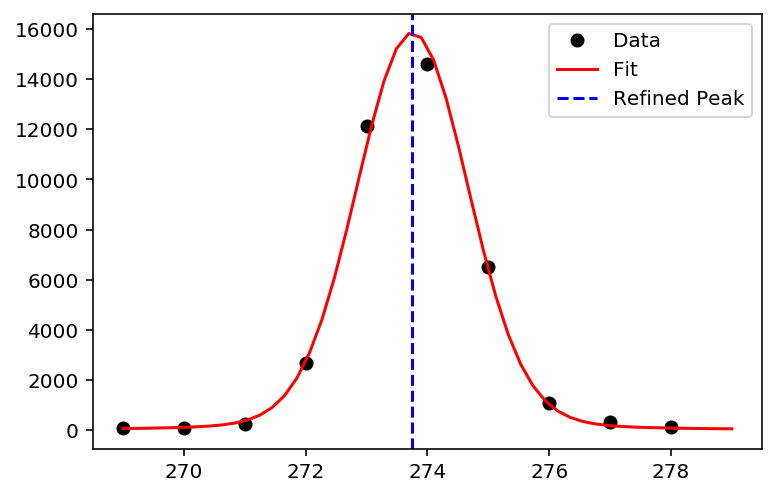

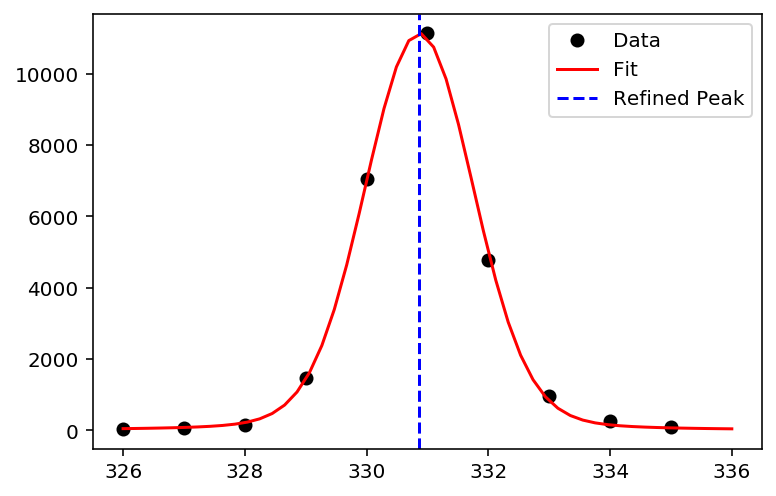

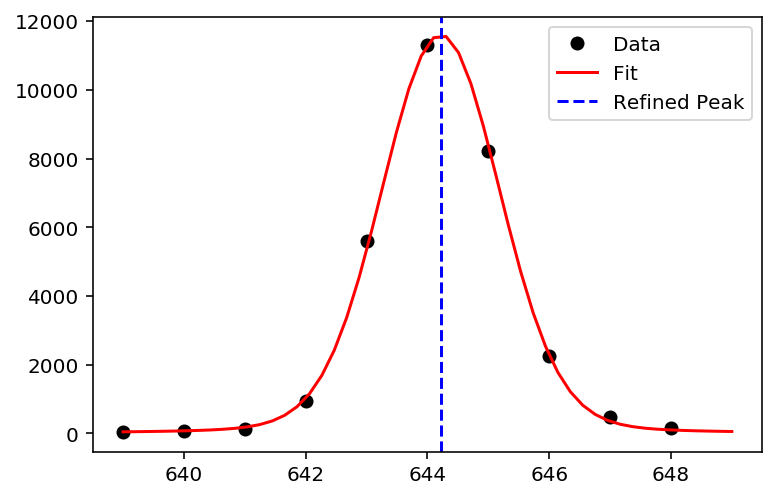

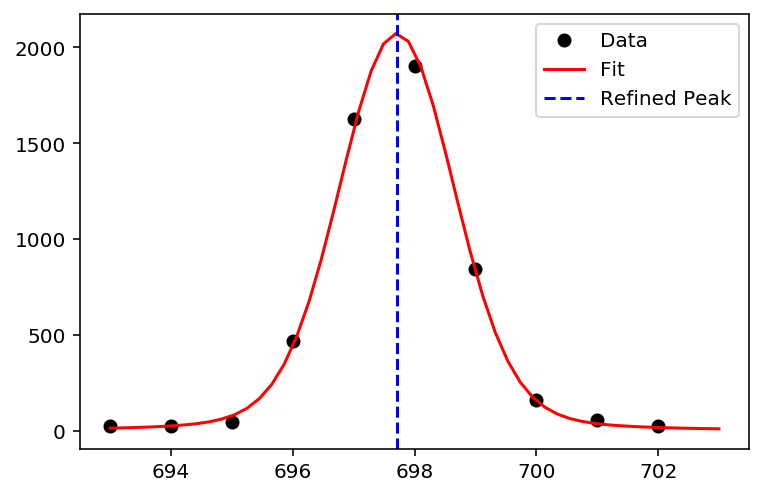

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


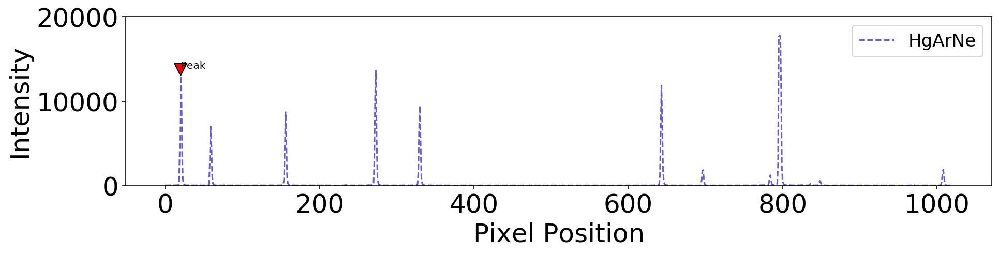

Keep peak at location 20? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


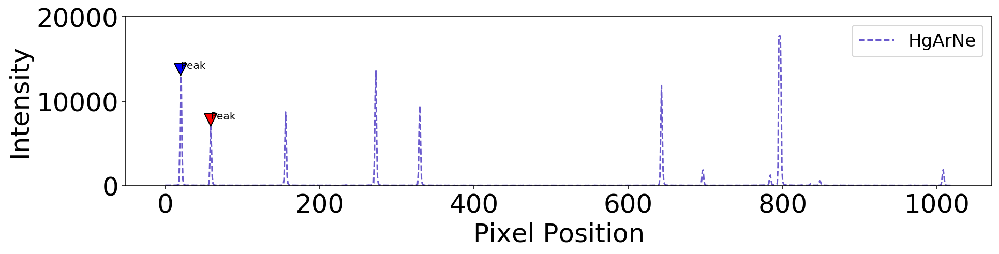

Keep peak at location 59? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


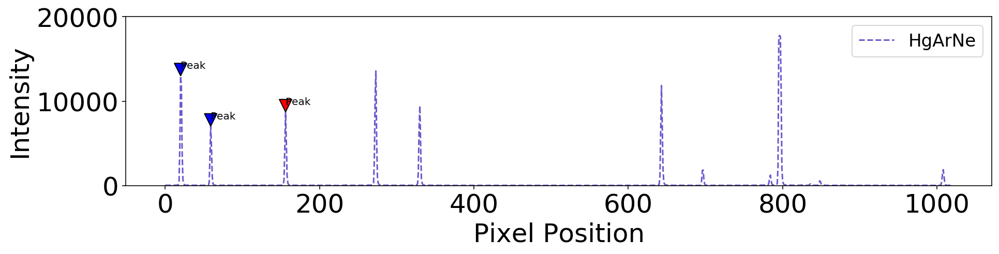

Keep peak at location 156? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


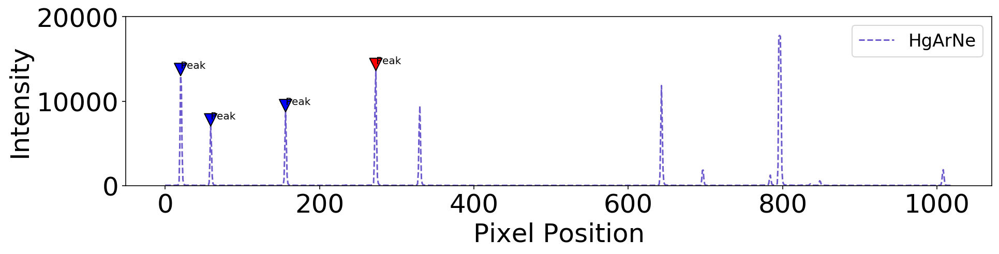

Keep peak at location 273? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


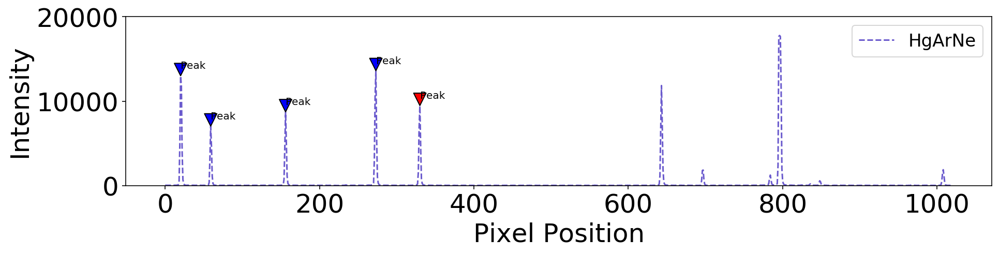

Keep peak at location 330? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


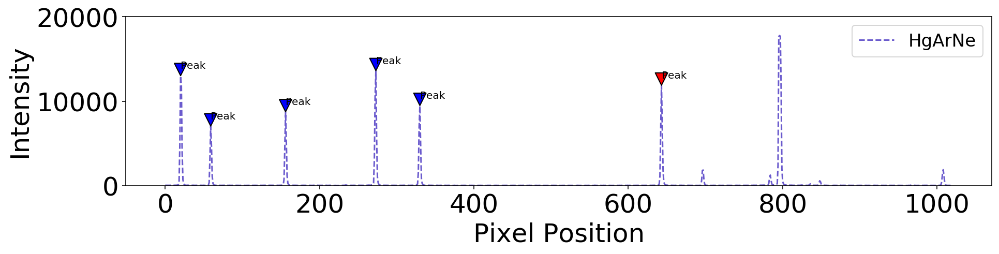

Keep peak at location 643? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


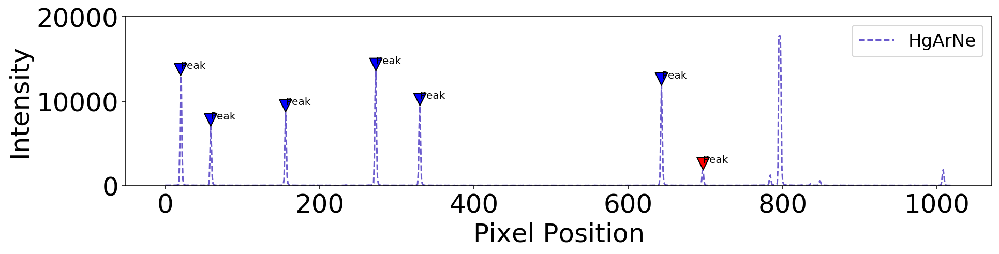

Keep peak at location 697? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


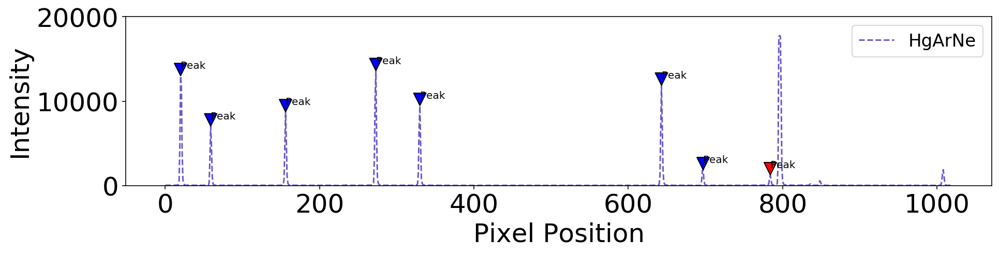

Keep peak at location 784? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


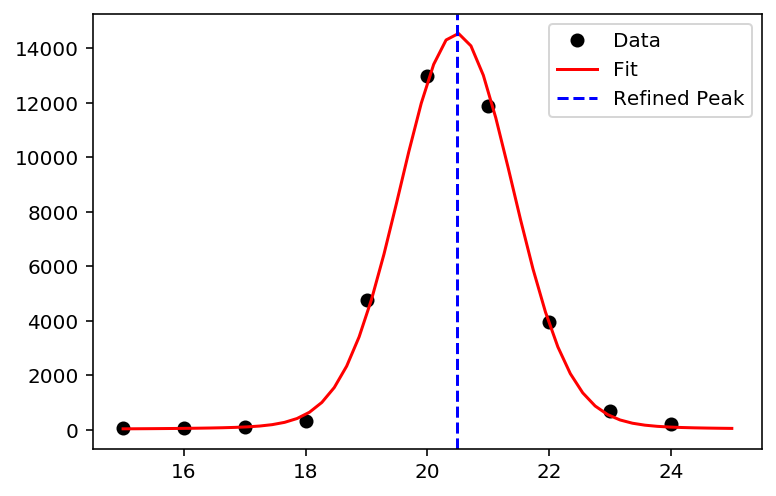

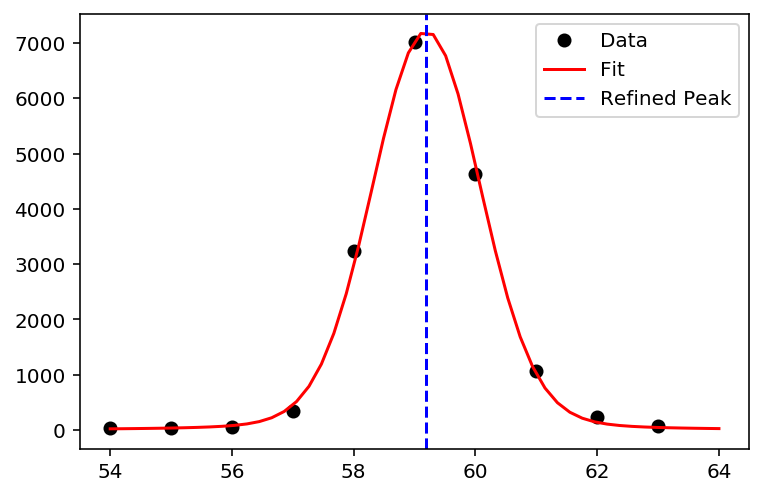

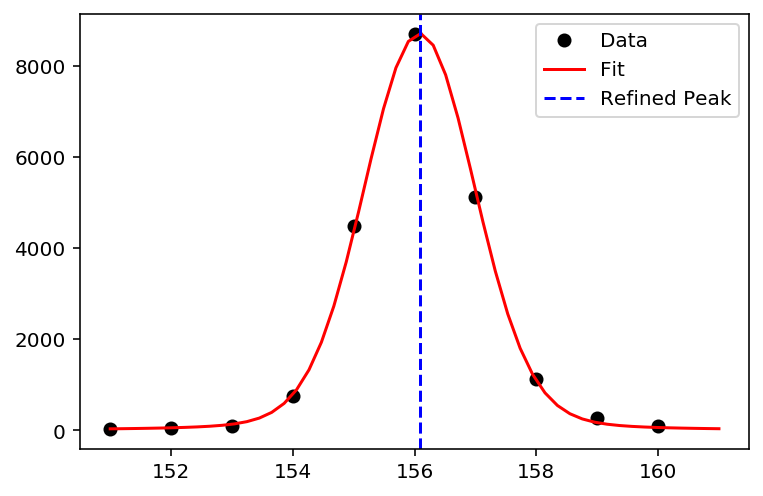

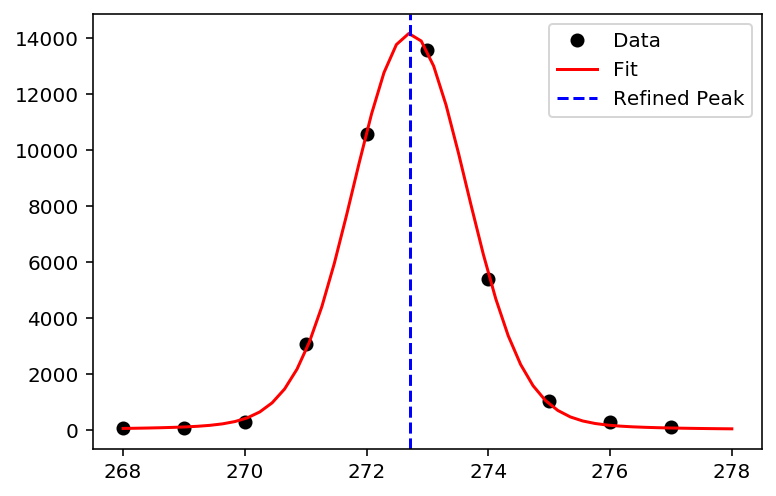

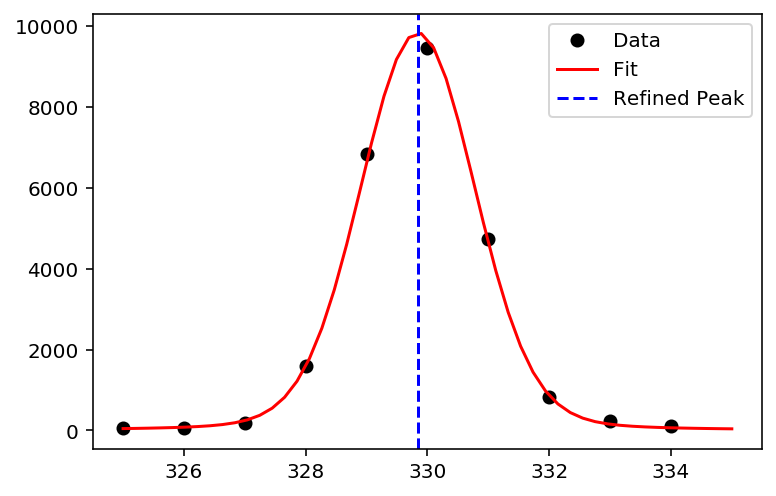

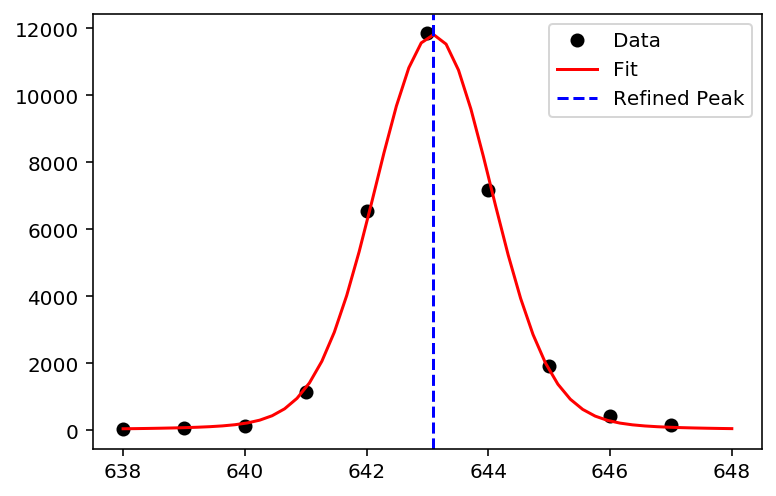

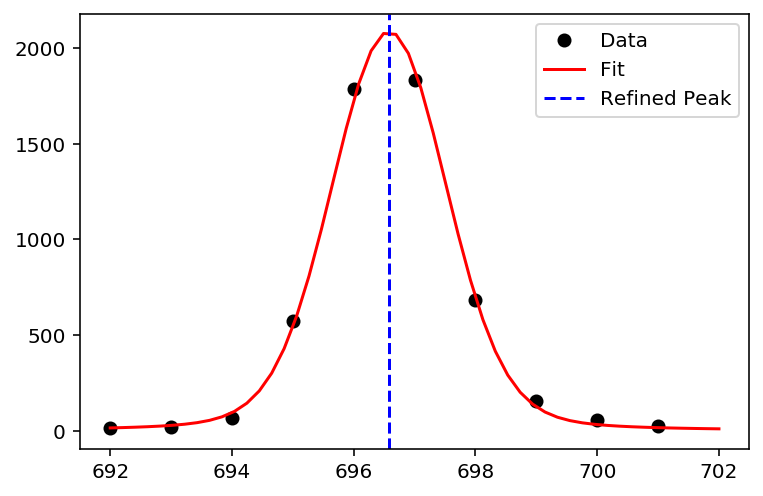

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


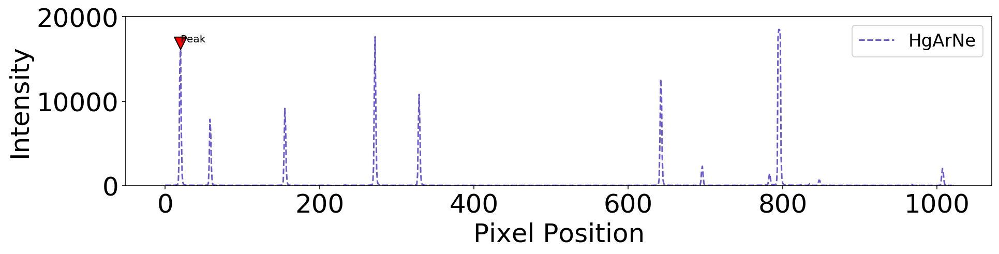

Keep peak at location 20? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


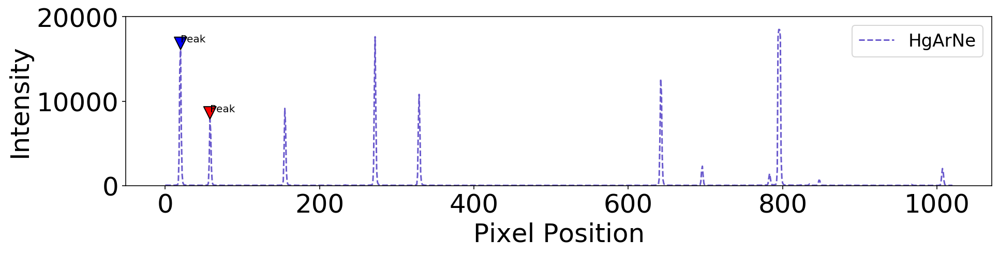

Keep peak at location 58? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


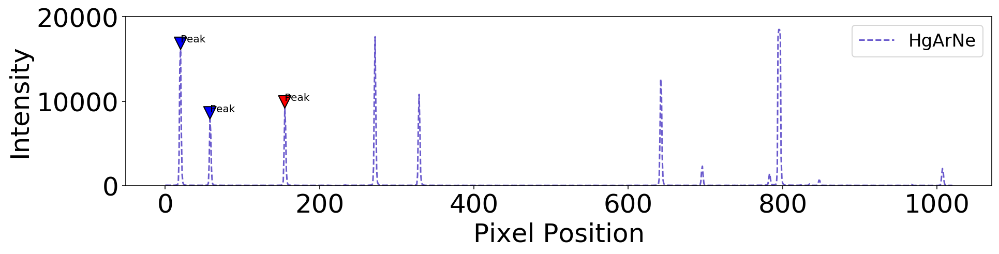

Keep peak at location 155? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


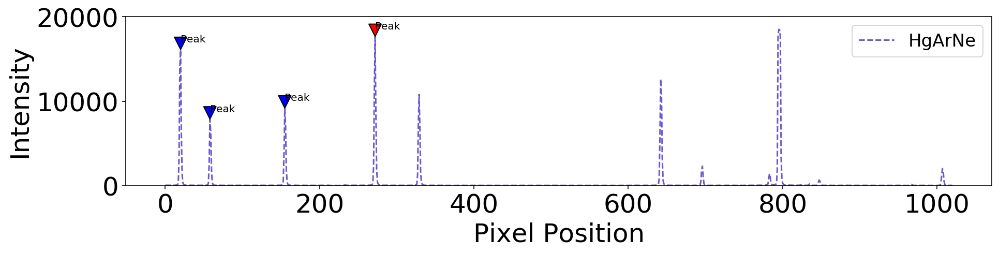

Keep peak at location 272? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


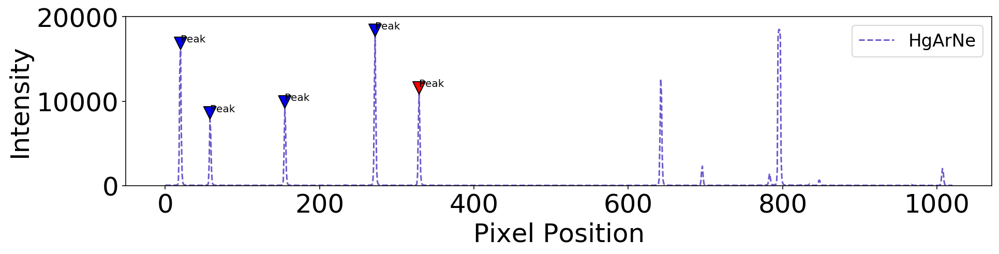

Keep peak at location 329? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


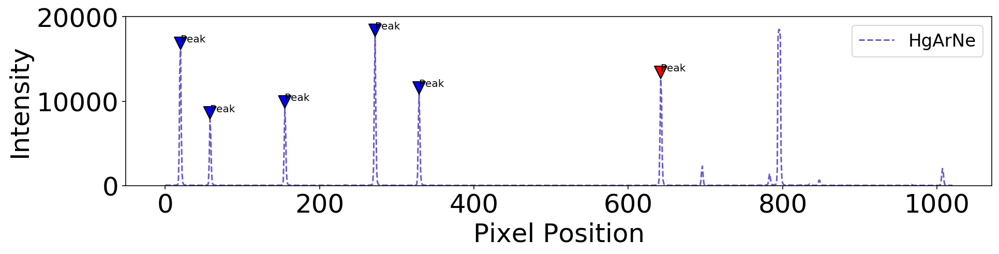

Keep peak at location 642? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


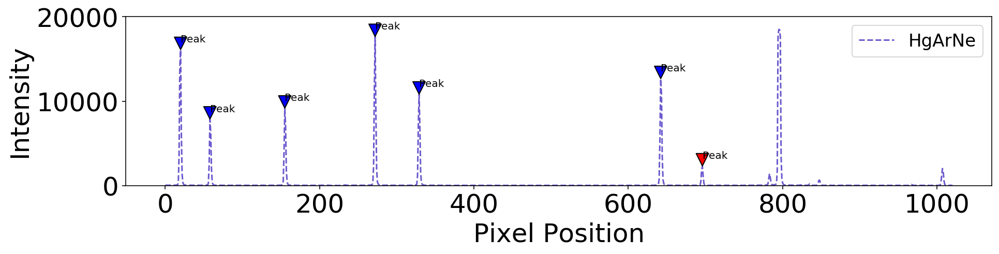

Keep peak at location 696? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


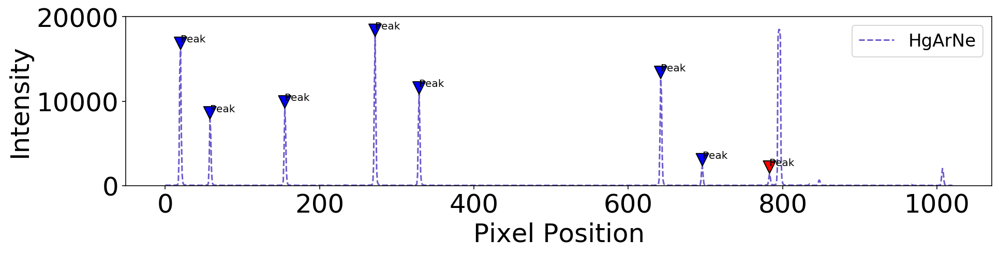

Keep peak at location 783? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


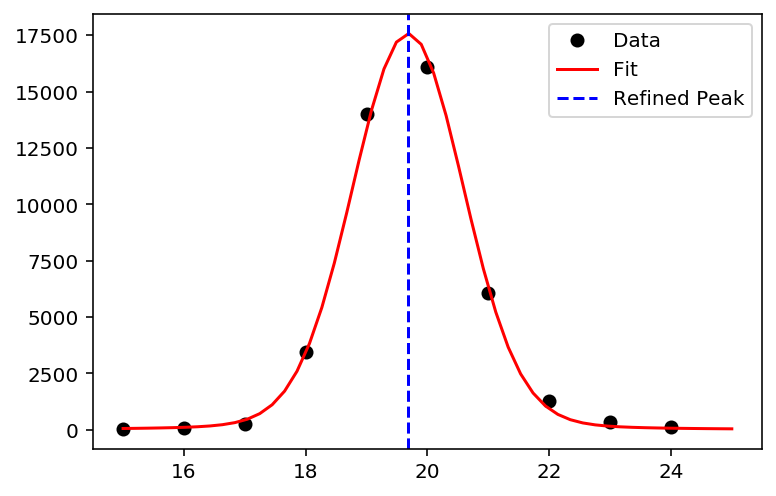

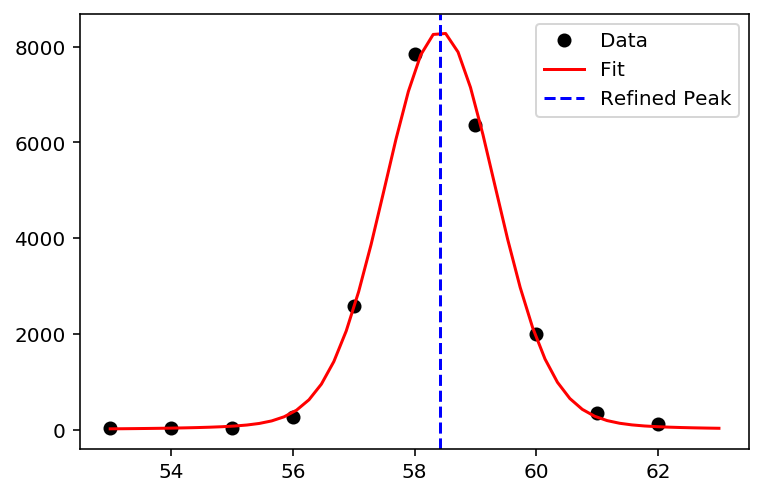

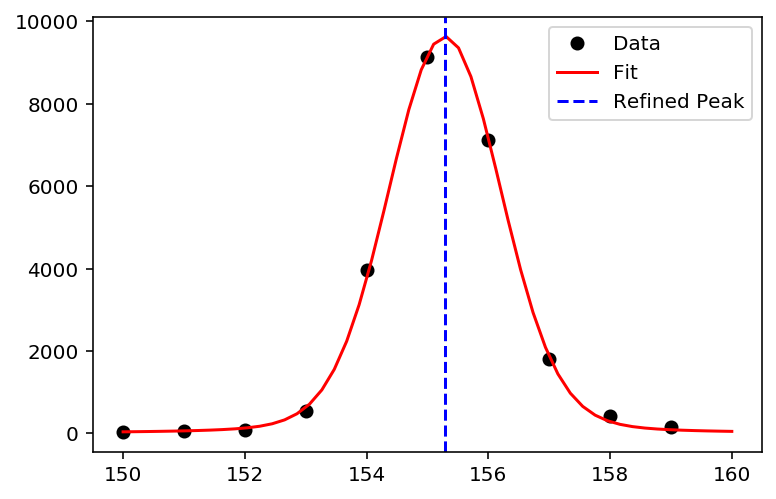

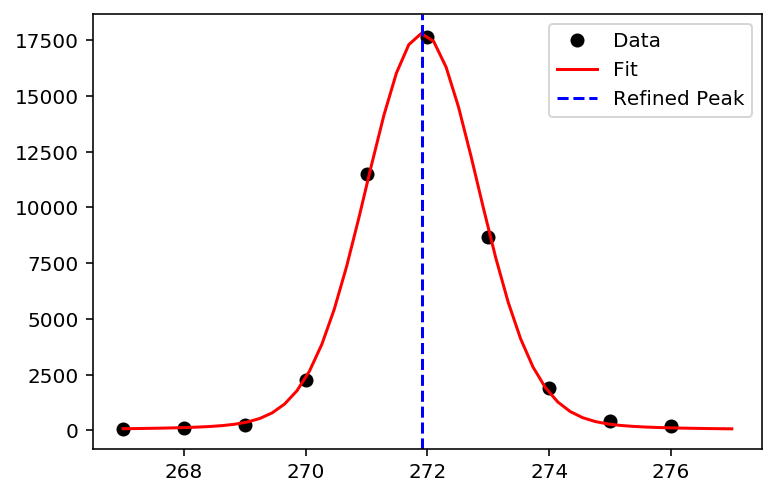

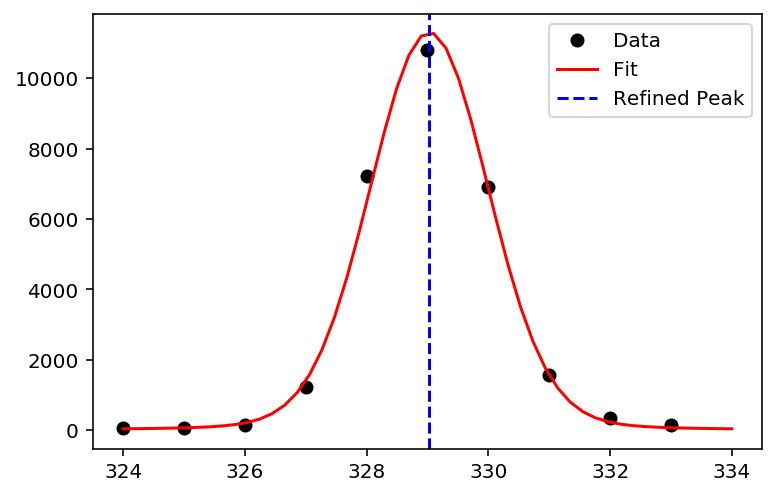

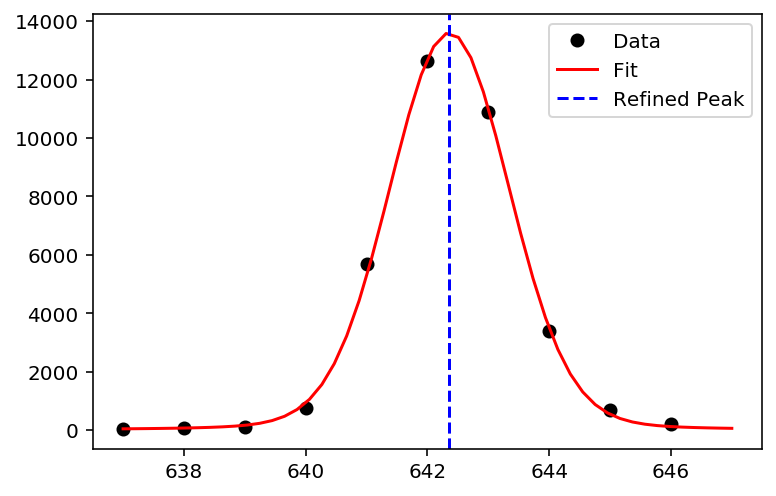

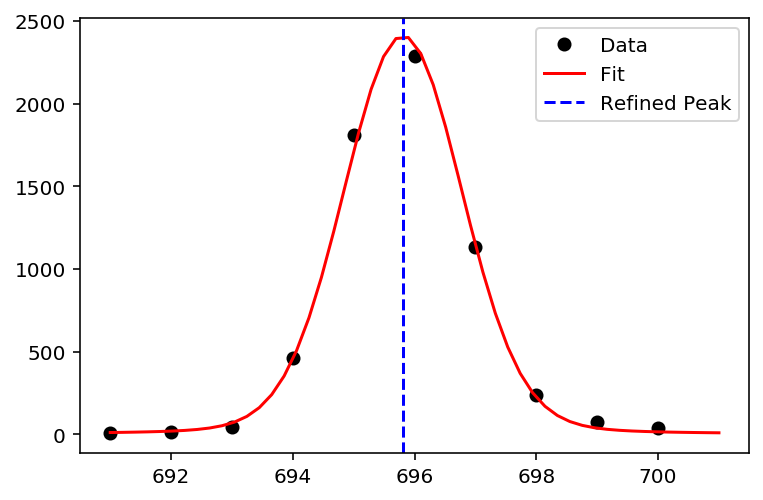

/data/des81.b/data/emarrufo/software/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


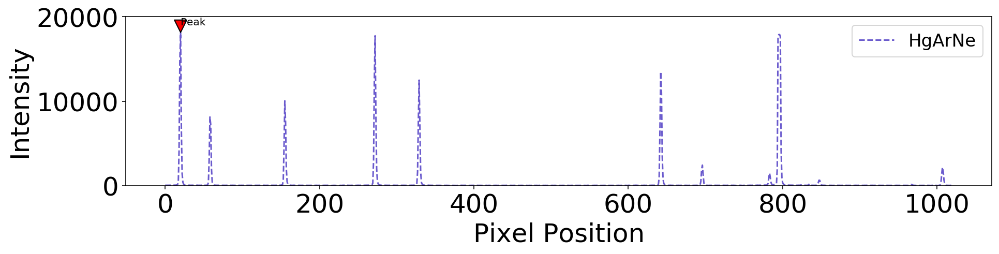

Keep peak at location 20? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


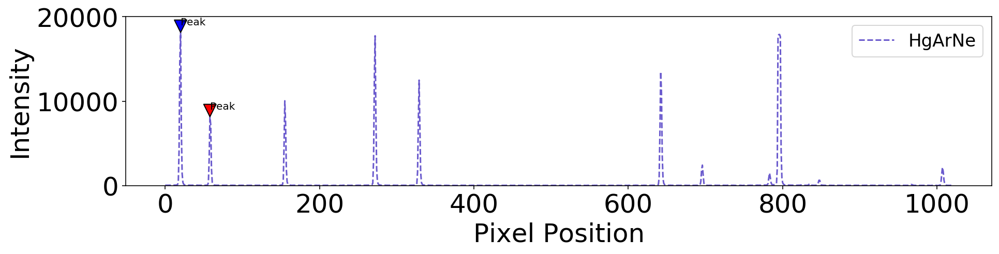

Keep peak at location 58? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


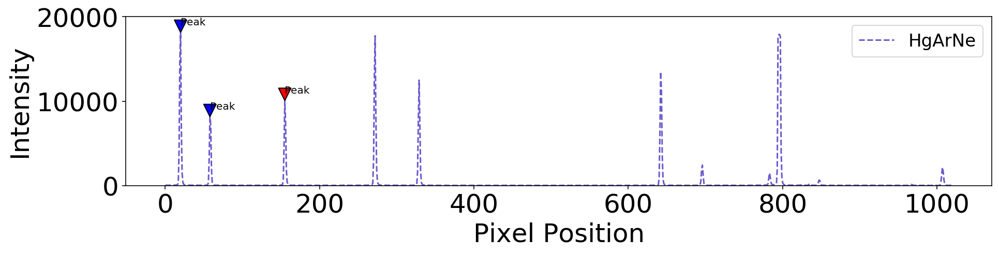

Keep peak at location 155? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


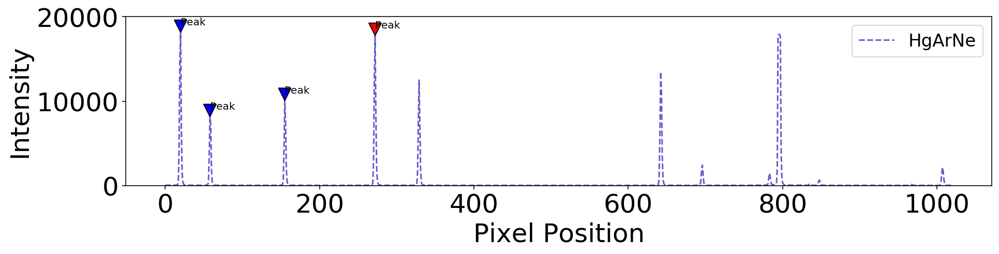

Keep peak at location 272? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


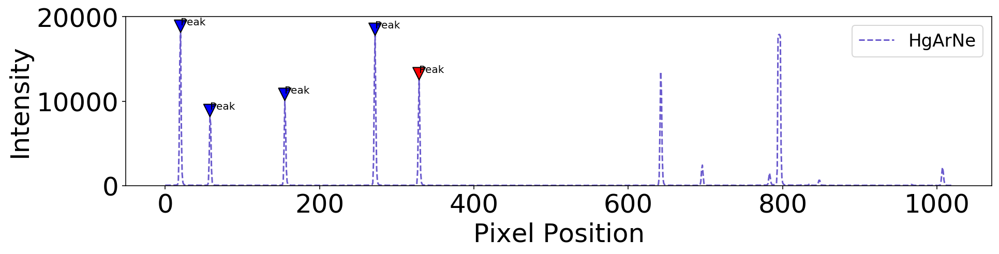

Keep peak at location 329? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


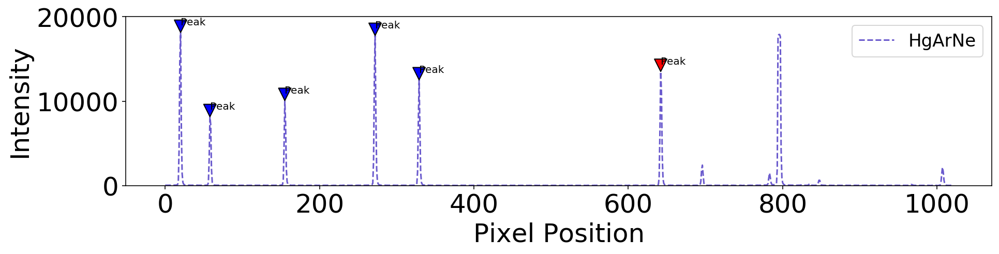

Keep peak at location 642? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


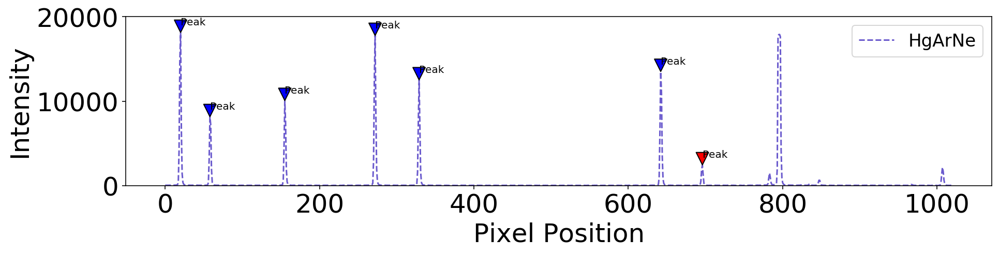

Keep peak at location 696? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): 


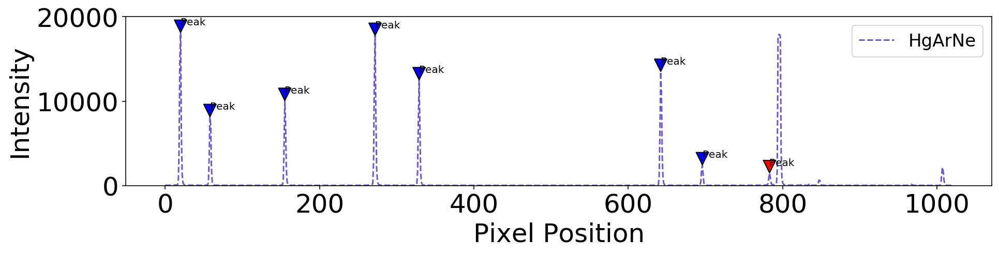

Keep peak at location 783? (Enter to keep, 'n' to exclude, 'all' to discard the rest, or 'q' to quit): all


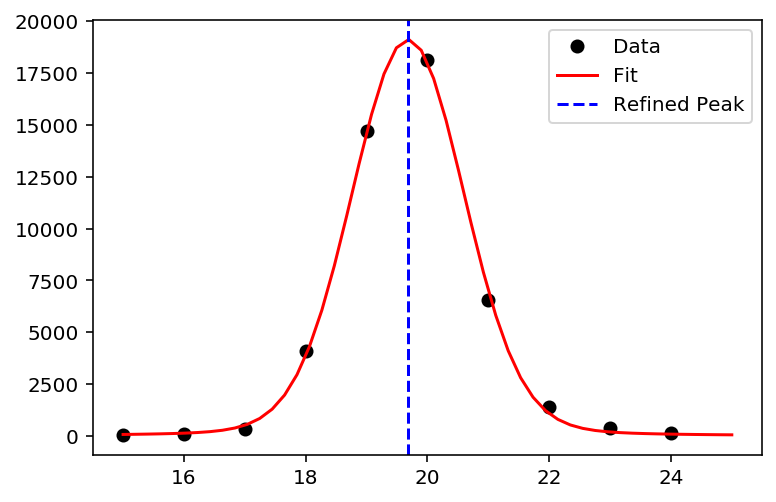

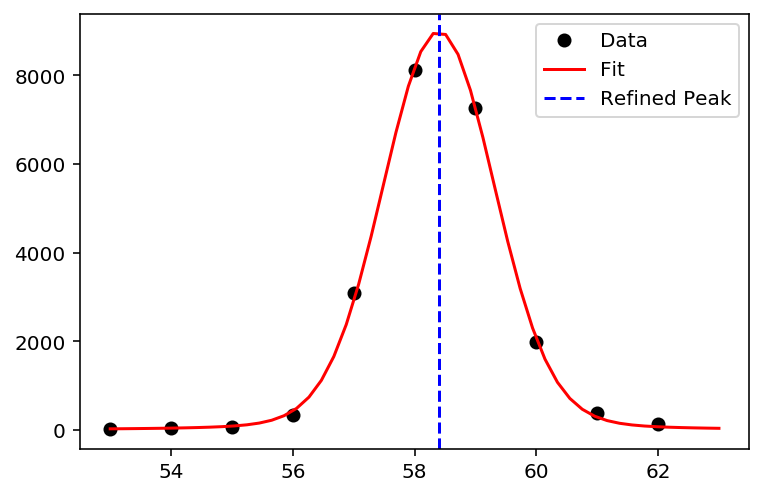

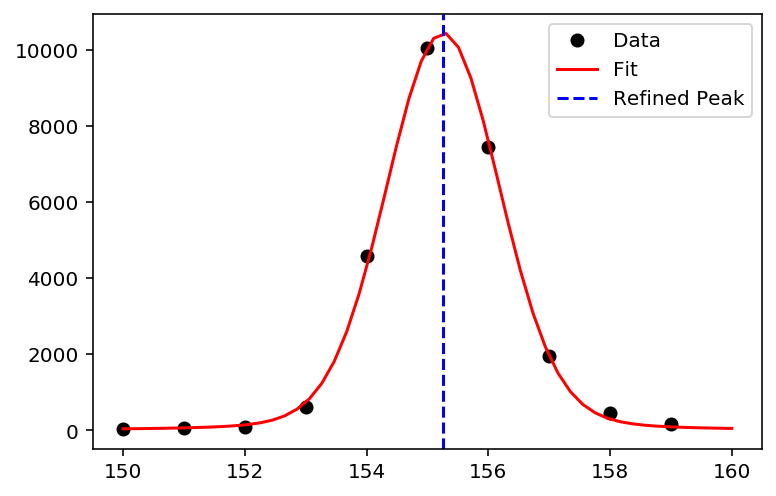

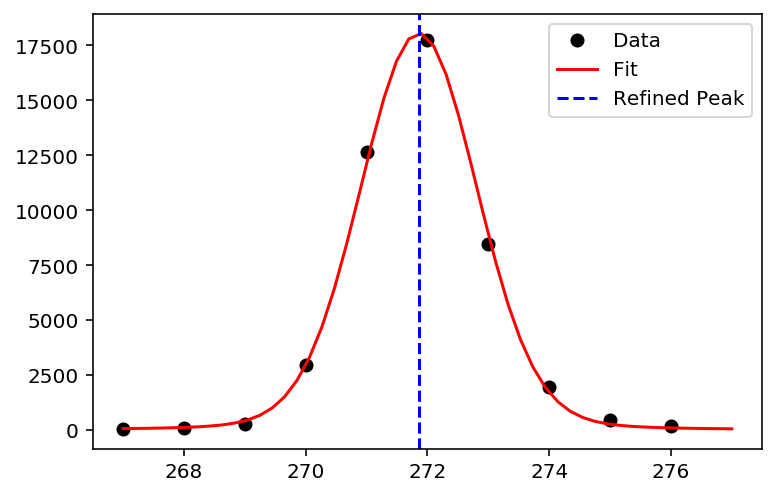

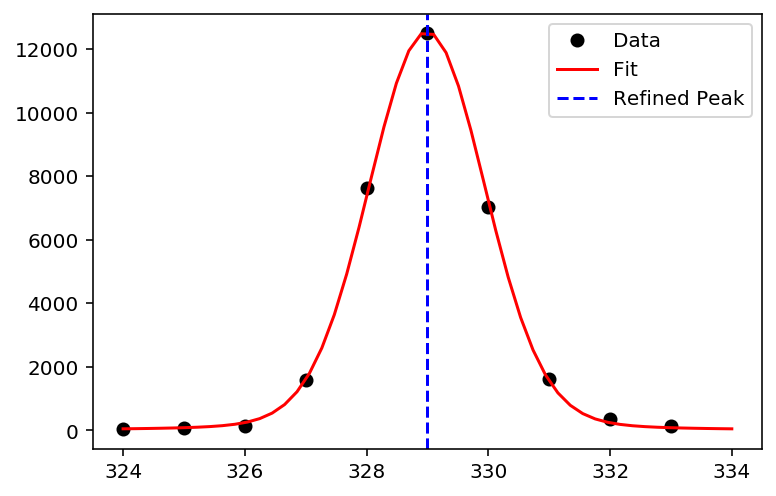

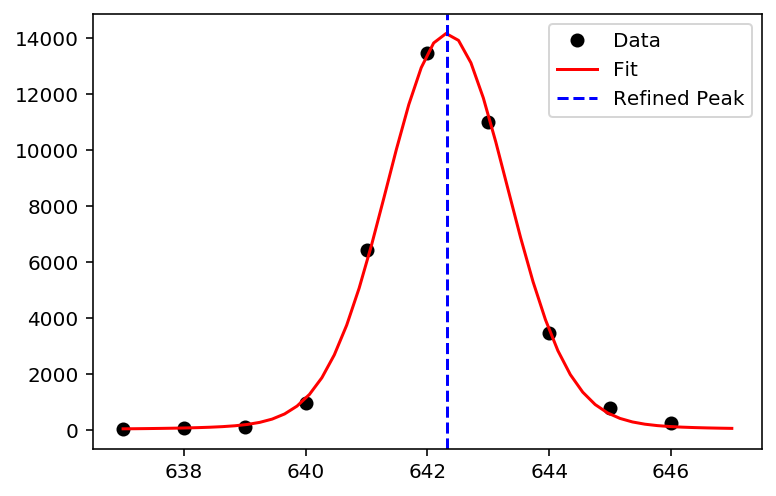

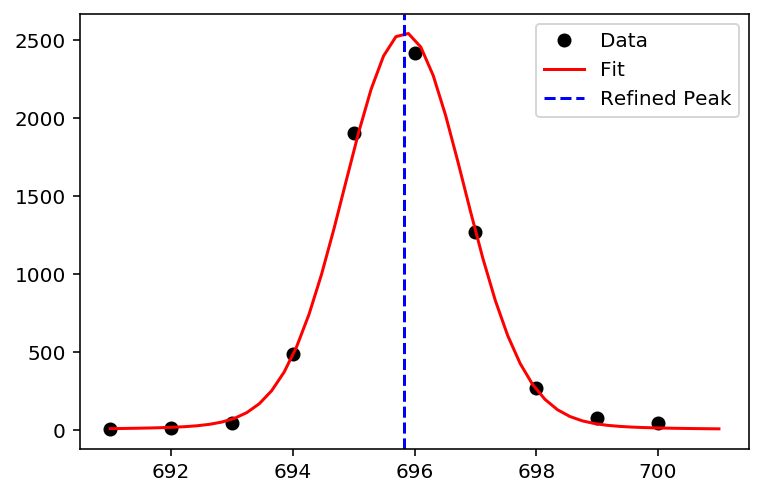

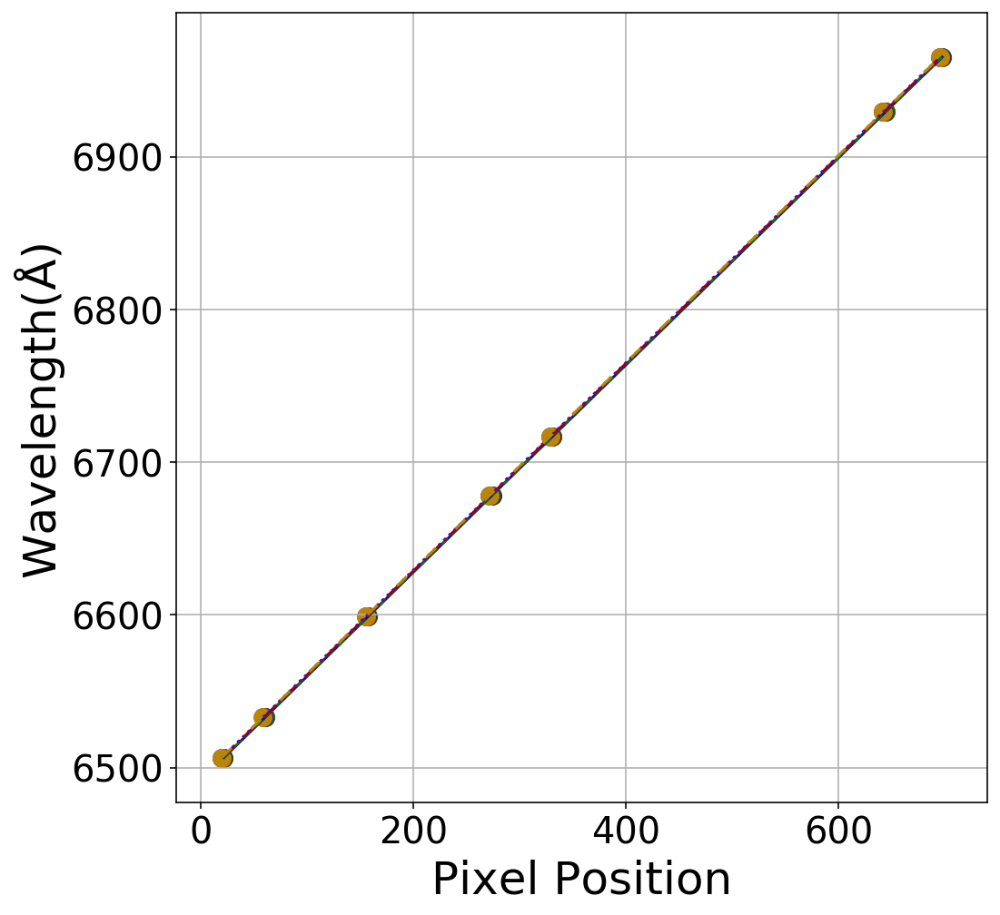

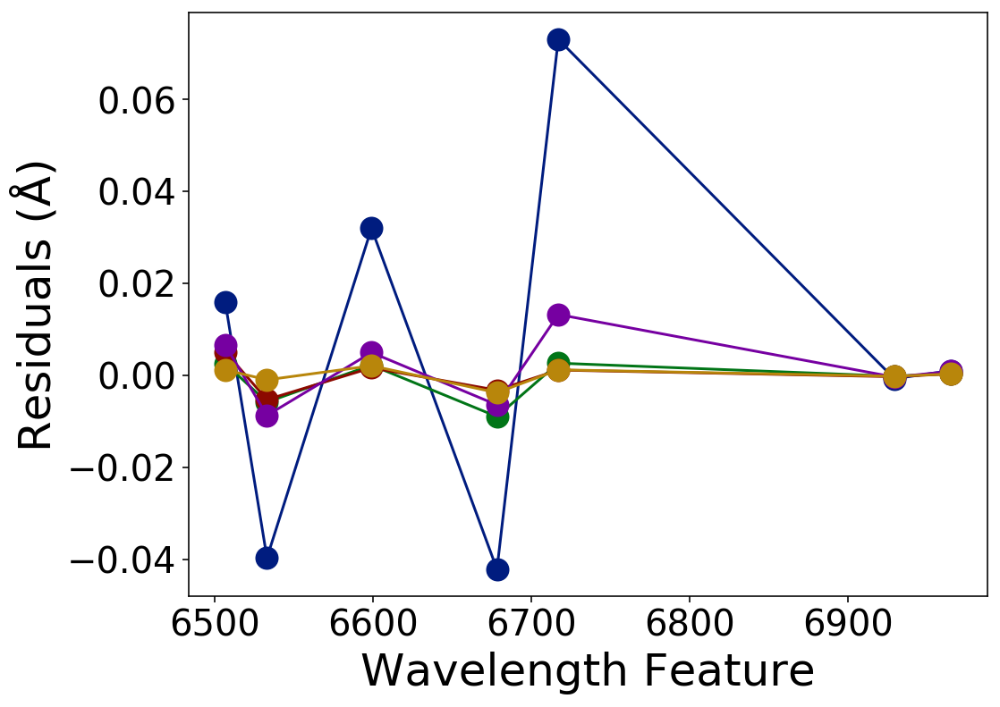

In [21]:
def wavelength_solution_bkg(det_img, calibration, slice_arr,det,height_cu=10,height_hg=600, plot_bkg=True):
    """
    Similar to wavelength_solutions, but computes the wavelength solution for background slices.

    Parameters
    ----------
    det_img : np.ndarray
        4D array (n_files, det_num, n_rows, n_cols).
    calibration : str
        'cu', 'hg', or 'both'.
    slice_arr : list of slice
        ROI slices in columns.
    det : int
        Detector index.
    height_cu : float, optional
        Cu line detection threshold.
    height_hg : float, optional
        Hg line detection threshold.
    plot_bkg : bool, optional
        Whether to plot the background region.

    Returns
    -------
    wav_all_bkg : np.ndarray
    wav_average_bkg : np.ndarray
    """
    
    bkg_slices_arr = list()
    offset=70
    bkg_size=20
    
    for slc in slice_arr:
        slice_bkg = slice(slc.start-offset,(slc.start-offset)+bkg_size)
        bkg_slices_arr.append(slice_bkg)
    
    
    if plot_bkg:
        
        for slc in bkg_slices_arr:
            
            fig, ax = plt.subplots(figsize=(30, 20))
            
            norm = ImageNormalize(det_img[0,det,:,:], 
                                  interval=ZScaleInterval(nsamples=1000,
                                                          contrast=0.07,
                                                          krej=15.5),
                                  stretch=SqrtStretch())
            plt.imshow(det_img[0,det,:,slc], origin='lower', norm=norm, cmap='gray')
            plt.show()

    
    wav_all_bkg, wav_average_bkg  = wavelength_solutions(calibration, cuhear, hghear, slice_arr, det=0, height_cu=height_cu,height_hg=height_hg)
    
    
    return wav_all_bkg, wav_average_bkg



wav_all_bkg, wav_average_bkg = wavelength_solution_bkg(bd_18_star_det,'hg', refined_slices,0)
        
        

## Radial velocity

In [22]:
def calculate_radial_velocity(lambdaObs, lambdaRest,coord,time):
    
    lambdaObs = lambdaObs*u.AA 
    lambdaRest = lambdaRest*u.AA
    
    v = const.c*(lambdaObs-lambdaRest)/lambdaRest
    
    pachon = EarthLocation.of_site('Cerro Pachon')
    skycoord = SkyCoord(coord,unit=(u.hourangle,u.deg),frame='icrs')
    
    barycor = skycoord.radial_velocity_correction(obstime=Time(time,scale='utc'),location=pachon)
    
    V_radial_corrected = (v+barycor).to(u.km/u.s)
    
    return(V_radial_corrected)


In [23]:
def voigt(x, x0, sigma, gamma, amplitude, offset):
    """
    Voigt function for curve-fitting spectral lines of interest.

    Parameters
    ----------
    x : np.ndarray
        Independent variable (e.g., wavelength).
    x0 : float
        Line center.
    sigma : float
        Gaussian sigma.
    gamma : float
        Lorentzian gamma.
    amplitude : float
        Absorption amplitude (peak).
    offset : float
        Baseline level.

    Returns
    -------
    np.ndarray
        Voigt profile values.
    """
    return offset - amplitude * voigt_profile(x - x0, sigma, gamma)


In [24]:
def calculate_initial_guesses(x_data, y_data, plot=True):
    """
    Generate initial guesses for Voigt profile.

    Returns
    -------
    [x0, sigma, gamma, amplitude, offset]
    """
    # Estimate the baseline (offset) using the median of the y_data
    offset = np.median(y_data)
    
    # Find the minima to estimate x0 (center) and amplitude
    minima_index = np.argmin(y_data)
    x0 = x_data[minima_index]
    minima = y_data[minima_index]
    
    # Calculate amplitude as the difference between baseline and minima
    amplitude = offset - minima
    
    # Estimate sigma and gamma based on the width of the absorption feature
    # Using the full width at half minimum (FWHM) for sigma and gamma
    half_max = offset - amplitude / 2
    indices_below_half_max = np.where(y_data < half_max)[0]
    
    if len(indices_below_half_max) > 1:
        # Calculate full width at half minimum (FWHM)
        fwhm = x_data[indices_below_half_max[-1]] - x_data[indices_below_half_max[0]]
        sigma = fwhm / (2 * np.sqrt(2 * np.log(2)))  # Convert FWHM to standard deviation
        gamma = fwhm / 2  # Rough estimate for gamma
    else:
        # In case we can't find a proper width, set default guesses
        sigma = (x_data[-1] - x_data[0]) / 10
        gamma = (x_data[-1] - x_data[0]) / 10
    
    
    if plot:
        
        plt.figure(figsize=(15, 4))
        plt.plot(x_data, y_data, label='Signal', color='blue')
        
        plt.axvline(x0, color='green', linestyle='--', label='Initial x0 (center)')
        
        plt.axhline(offset, color='purple', linestyle='--', label='Initial Offset (baseline)')
        
        plt.annotate(
        '', xy=(x0, minima), xytext=(x0, offset),
            arrowprops=dict(arrowstyle='<->', color='red', lw=2),
        )
        
        plt.text(x0, (minima + offset) / 2, 'Amplitude', color='red', ha='left', va='center',fontsize=15)
        
        plt.axvspan(x0 - sigma, x0 + sigma, alpha=0.2, color='orange', label='Approximate Sigma Region')
        plt.axvspan(x0 - gamma, x0 + gamma, alpha=0.2, color='cyan', label='Approximate Gamma Region')
        plt.legend(loc='best',fontsize=15)
        plt.tick_params(axis='both', labelsize=20)
        plt.ylabel('Signal(e-)',fontsize=25)
        plt.xlabel('Wavelength',fontsize=25)
        plt.show()
    
    return [x0, sigma, gamma, amplitude, offset]

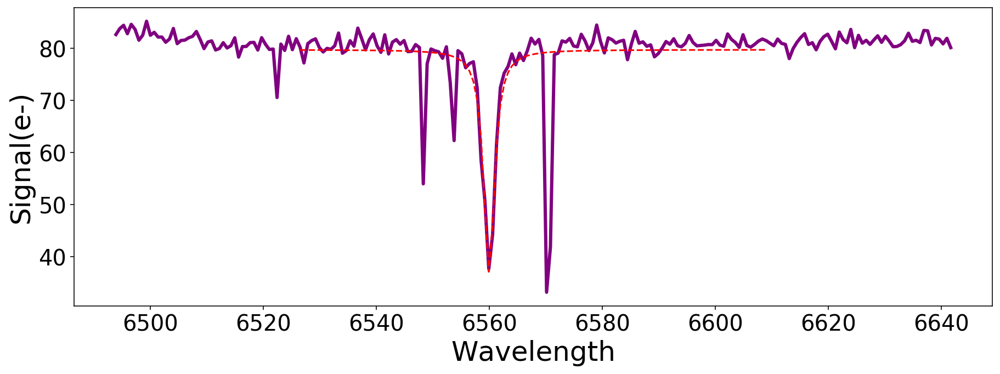

In [39]:
# Fit spectral feature
def extract_sig(target_data, det, slices,mask=True):
    """
    Extract and fit a spectral line from target data with optional bkg subtraction.

    Parameters
    ----------
    target_data : np.ndarray
        4D array, shape (n_files, det_num, n_rows, n_cols).
    det : int
        Detector index to extract from.
    slices : list of slice
        Column slices for spectral orders/fibers.
    wav_all : np.ndarray
        Wavelength solutions from `wavelength_solutions`.
    wav_average : np.ndarray
        Mean solution across slices.
    wav_all_bkg : np.ndarray
        Wavelength solutions if background is used.
    wav_average_bkg : np.ndarray
        Mean solution if background is used.
    mask : bool, optional
        Simple outlier mask on final flux.

    Returns
    -------
    None
    """
    sig = list()
    bkg = list()
    offset=70
    bkg_size=20
    
    combined_flux = list()
    bkg_slices=list()

    fit_start= 50
    fit_end = -50
    

    
    
    for idx, slc in enumerate(slices):
        
        
        
        sig_bundle = target_data[0,det,:,slc].T

        slice_bkg = slice(slc.start-offset,(slc.start-offset)+bkg_size)
        
        bkg_sig = target_data[0,det,:,slice_bkg].T

        
        sig_mean, sig_median, sig_std = sigma_clipped_stats(sig_bundle,axis=0,sigma=3.5)
        bkg_mean, bkg_median, bkg_std = sigma_clipped_stats(bkg_sig,axis=0,sigma=3.5)
        
        
        
        
        
        
        
        interp_spectrum = interp1d(wav_all[idx][:-800], sig_mean[:-800], kind='linear', bounds_error=False, fill_value=0)
        interp_bkg = interp1d(wav_all_bkg[idx][:-800], bkg_mean[:-800], kind='linear', bounds_error=False, fill_value=0)

        
        flux_new = interp_spectrum(wav_average[:-800])
        bkg_new = interp_bkg(wav_average[:-800])
        
        combined_flux.append(flux_new-bkg_new)
 
    
    sig_mean, sig_median, sig_std = sigma_clipped_stats(np.array(combined_flux),axis=0,sigma=3.5)
    WAV_fit = wav_average[:-800]
    
    if mask:
        percentage= 100
        central_value = np.median(sig_mean)
        lower_limit = central_value * (1 - percentage / 100)
        upper_limit = central_value * (1 + percentage / 100)
        
        sig_mean = np.where((sig_mean < lower_limit) | (sig_mean > upper_limit), central_value, sig_mean)

    
    # Fitting
    
    initial_guess =  calculate_initial_guesses(WAV_fit[fit_start:fit_end],sig_mean[fit_start:fit_end],plot=False)
    popt, pcov = curve_fit(voigt, WAV_fit[fit_start:fit_end], sig_mean[fit_start:fit_end], p0=initial_guess,maxfev=50000)
    fitted_x0, fitted_sigma, fitted_gamma, fitted_amplitude, fitted_offset = popt
    
    fitted_y_data = voigt(WAV_fit[fit_start:fit_end], *popt)
        
    plt.figure(figsize=(15, 5))
    plt.plot(WAV_fit[2:-2], sig_mean[2:-2], linewidth=3, color='purple')
    plt.plot(WAV_fit[fit_start:fit_end], fitted_y_data, 'r--')

    plt.xlabel('Wavelength',fontsize=25)
    plt.ylabel('Signal(e-)',fontsize=25)
    plt.tick_params(axis='both', labelsize=20)
    plt.show()
    

extract_sig(bd_18_star_det, 0, refined_slices)